# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [5]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [6]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [7]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [8]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [9]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [10]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [12]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [13]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.2412060326337815, discriminator loss: 0.25426280811801555


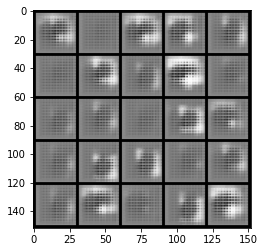

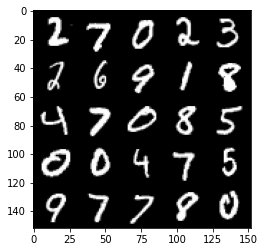

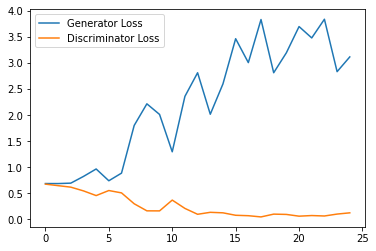

Step 1000: Generator loss: 4.374314257144928, discriminator loss: 0.03454843753017485


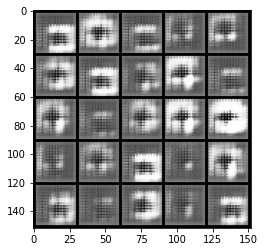

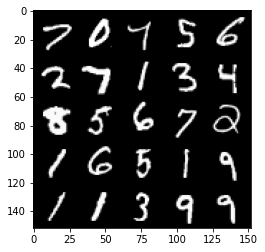

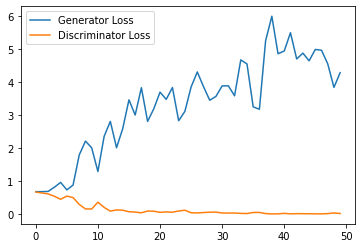

Step 1500: Generator loss: 4.5769552154541016, discriminator loss: 0.04377039952017367


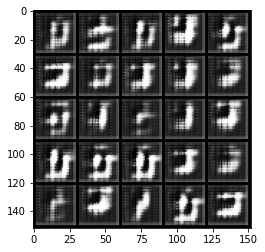

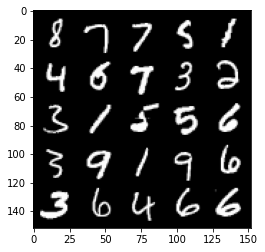

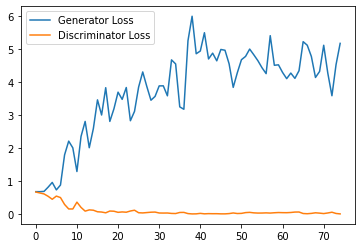

Step 2000: Generator loss: 3.354199363708496, discriminator loss: 0.11435227290168405


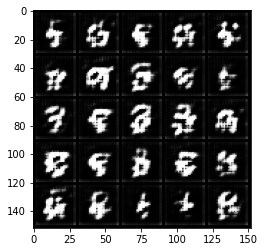

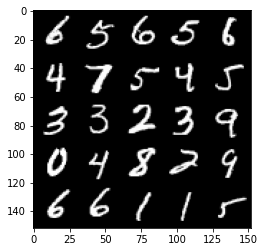

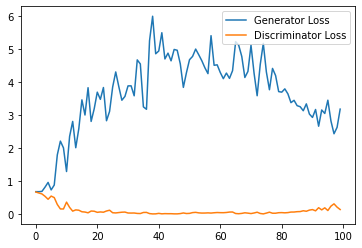

Step 2500: Generator loss: 2.786727385044098, discriminator loss: 0.21820686151087285


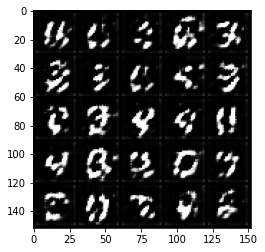

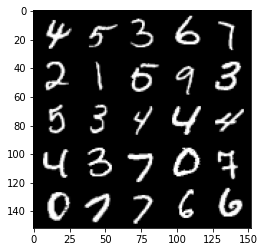

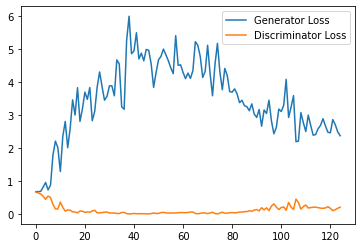

Step 3000: Generator loss: 2.5637591705322267, discriminator loss: 0.22561930605769157


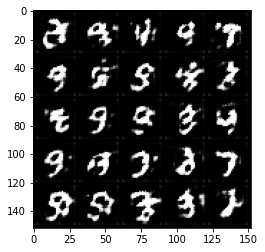

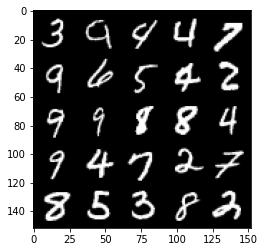

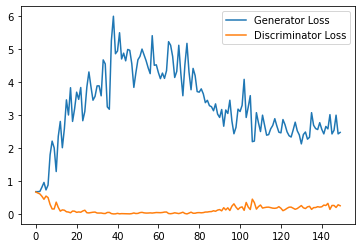

Step 3500: Generator loss: 2.175014214038849, discriminator loss: 0.2917258025407791


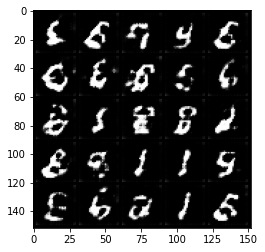

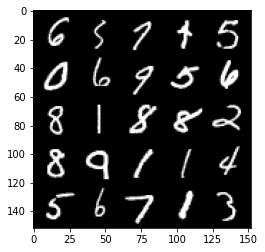

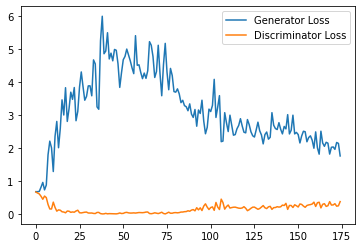

Step 4000: Generator loss: 2.0656973159313203, discriminator loss: 0.30124408316612244


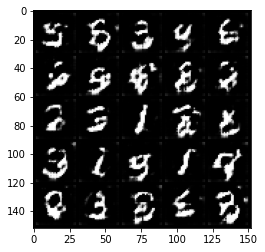

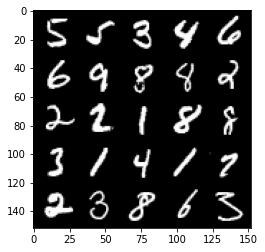

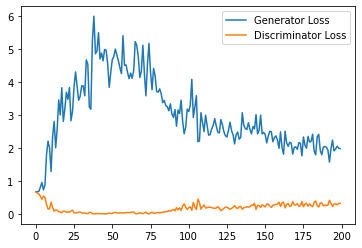

Step 4500: Generator loss: 2.328983301639557, discriminator loss: 0.30813702328503134


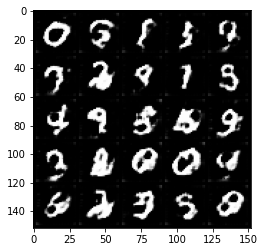

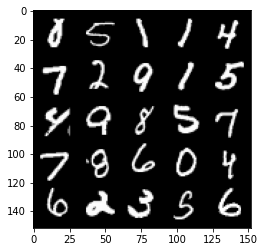

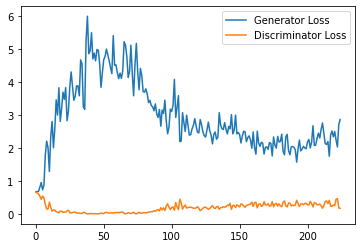

Step 5000: Generator loss: 1.7918667747974395, discriminator loss: 0.3608572054207325


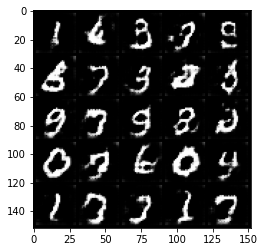

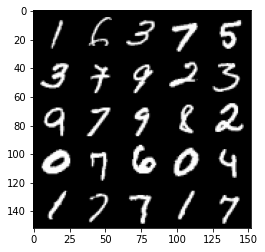

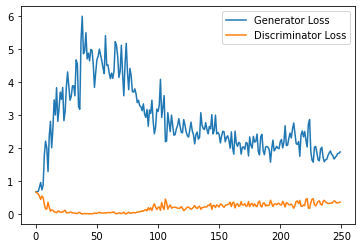

Step 5500: Generator loss: 1.8368786706924438, discriminator loss: 0.3758438932001591


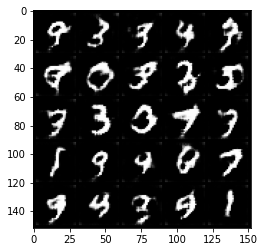

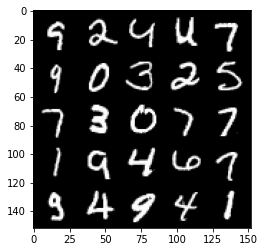

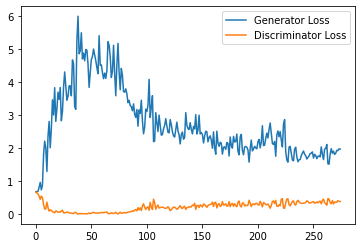

Step 6000: Generator loss: 1.733549427509308, discriminator loss: 0.40167682358622553


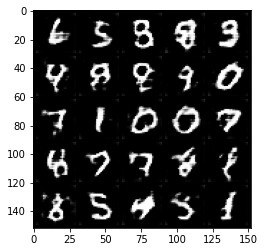

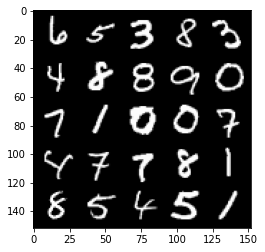

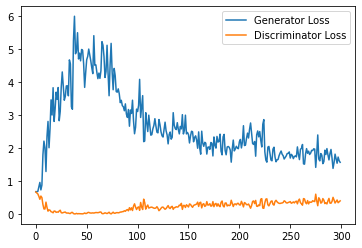

Step 6500: Generator loss: 1.6970179390907287, discriminator loss: 0.395449805855751


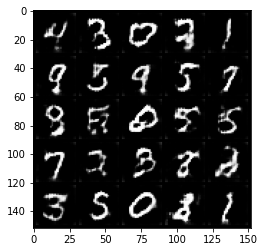

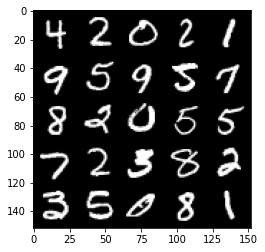

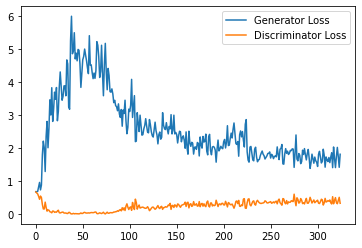

Step 7000: Generator loss: 1.6709786555767059, discriminator loss: 0.4270580241680145


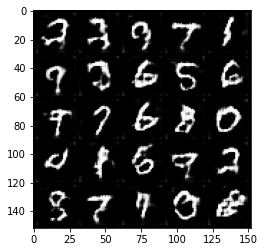

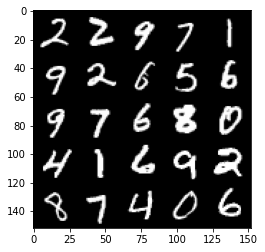

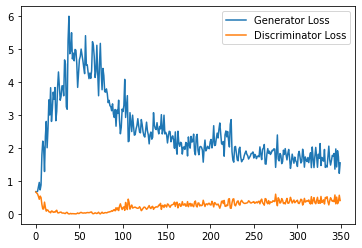

Step 7500: Generator loss: 1.5448447992801666, discriminator loss: 0.4403246769607067


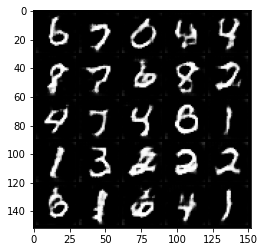

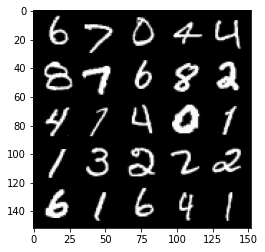

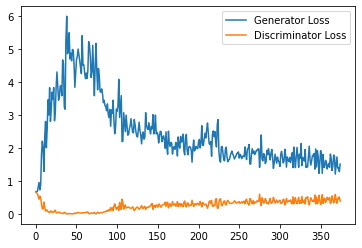

Step 8000: Generator loss: 1.4567656310796737, discriminator loss: 0.4668930367827415


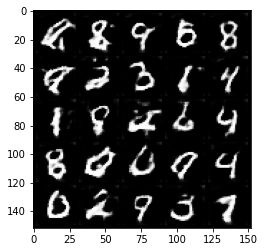

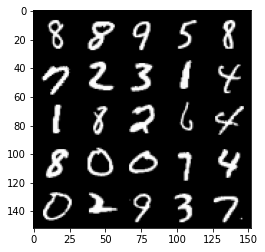

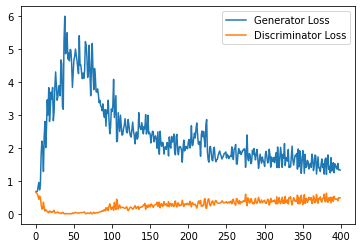

Step 8500: Generator loss: 1.455264464378357, discriminator loss: 0.4703005282878876


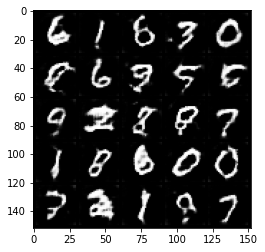

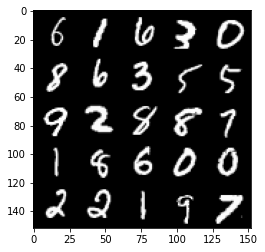

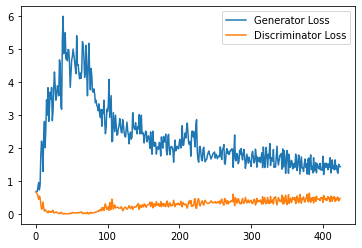

Step 9000: Generator loss: 1.3673125418424605, discriminator loss: 0.4860617001056671


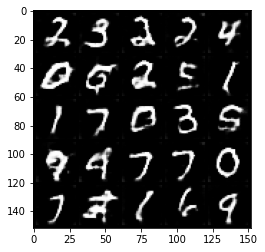

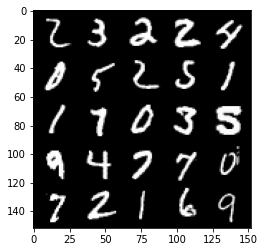

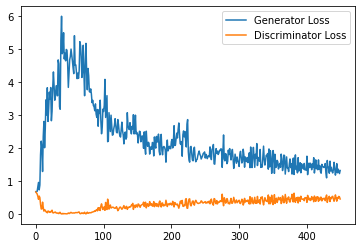

Step 9500: Generator loss: 1.360120611667633, discriminator loss: 0.5084463628530502


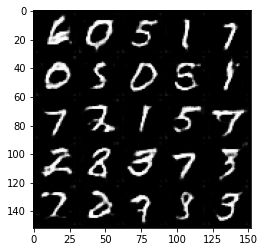

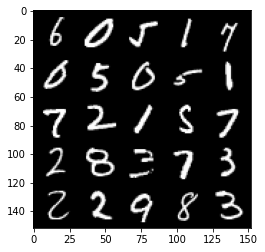

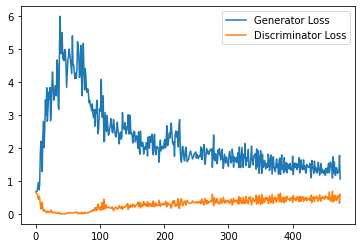

Step 10000: Generator loss: 1.2517732120752334, discriminator loss: 0.5153484313488007


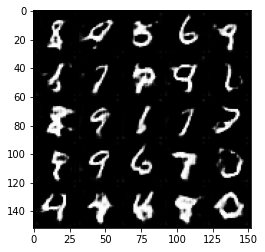

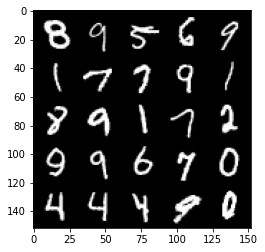

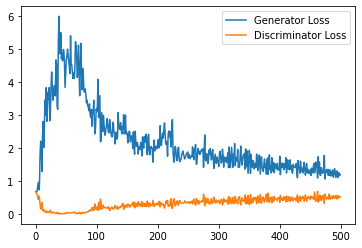

Step 10500: Generator loss: 1.269949580669403, discriminator loss: 0.5327402969002724


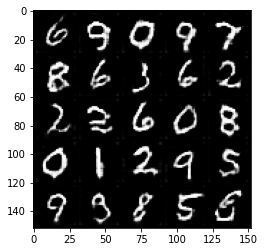

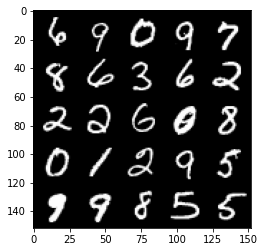

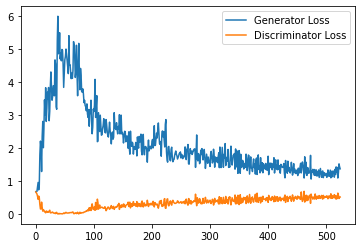

Step 11000: Generator loss: 1.2584416843652726, discriminator loss: 0.5408013854026794


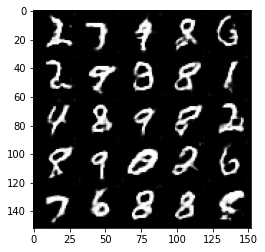

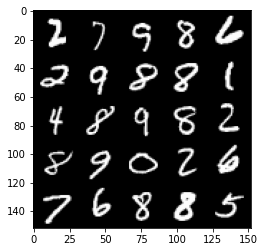

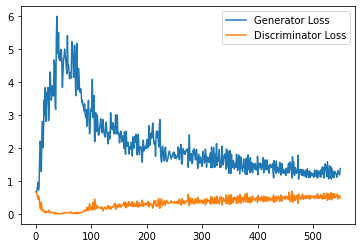

Step 11500: Generator loss: 1.2415630705356597, discriminator loss: 0.5402425706982613


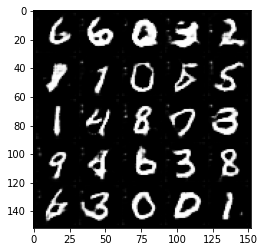

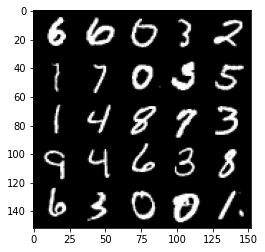

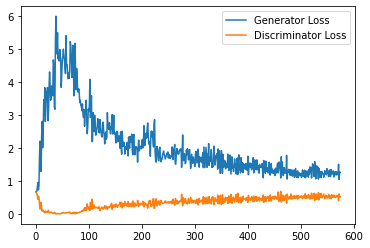

Step 12000: Generator loss: 1.184630152463913, discriminator loss: 0.5443406662940979


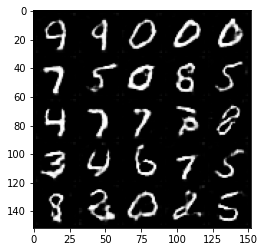

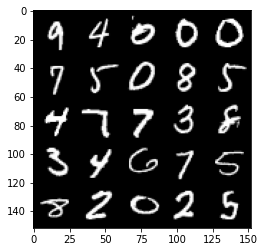

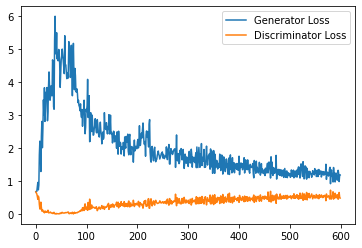

Step 12500: Generator loss: 1.1405851687192916, discriminator loss: 0.5496244353055953


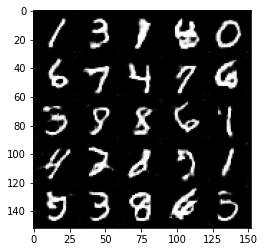

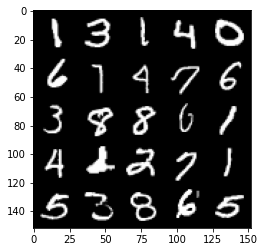

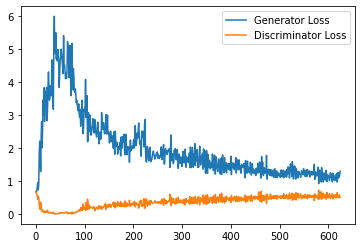

Step 13000: Generator loss: 1.1676745727062225, discriminator loss: 0.5537209652066231


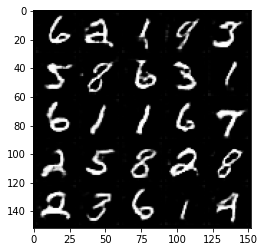

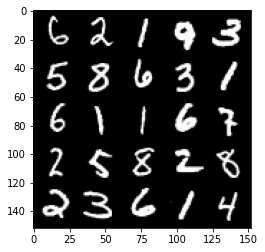

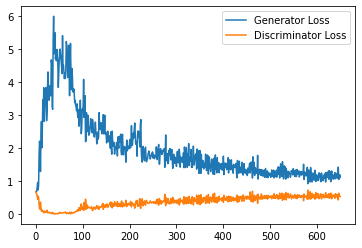

Step 13500: Generator loss: 1.1703063278198242, discriminator loss: 0.5564909900426864


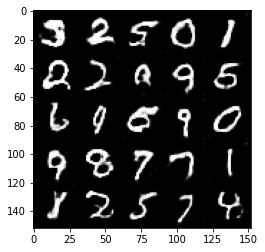

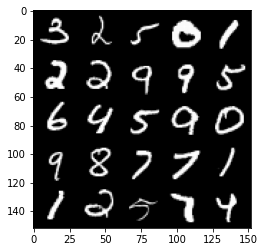

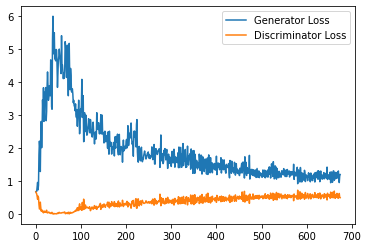

Step 14000: Generator loss: 1.1700397634506225, discriminator loss: 0.5655984978079795


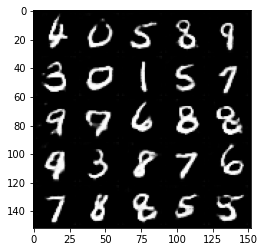

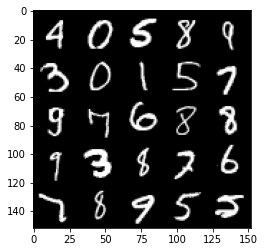

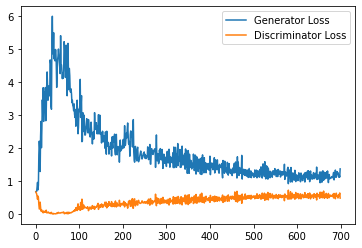

Step 14500: Generator loss: 1.1294211213588714, discriminator loss: 0.5670167428851127


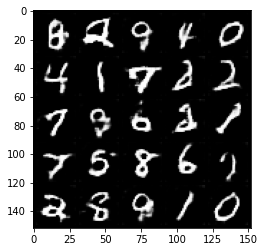

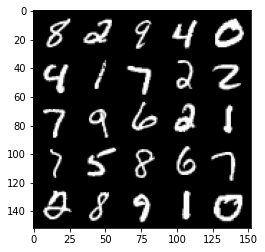

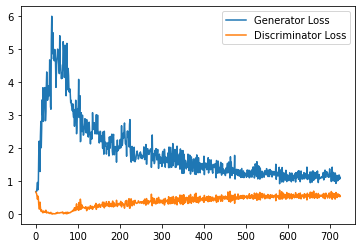

Step 15000: Generator loss: 1.128855525970459, discriminator loss: 0.5741535859704018


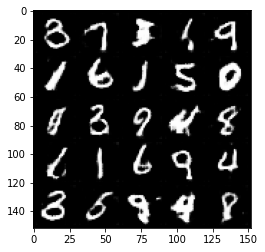

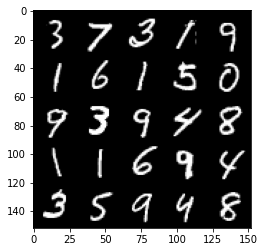

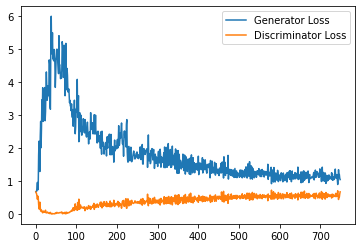

Step 15500: Generator loss: 1.1144655355215072, discriminator loss: 0.5753885739445687


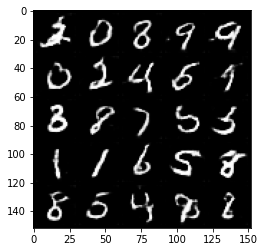

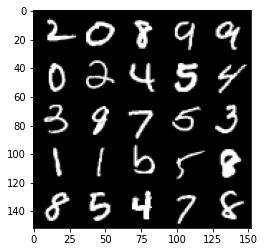

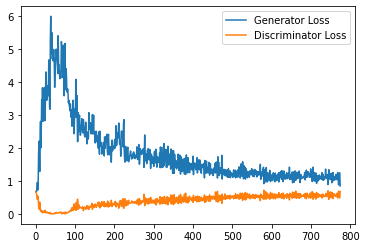

Step 16000: Generator loss: 1.0813875694274901, discriminator loss: 0.575073968052864


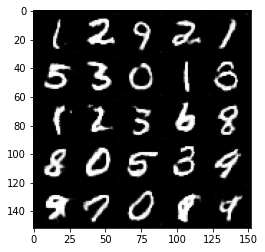

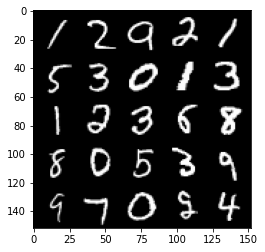

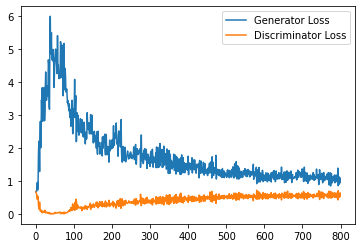

Step 16500: Generator loss: 1.0424444744586945, discriminator loss: 0.5793916509747505


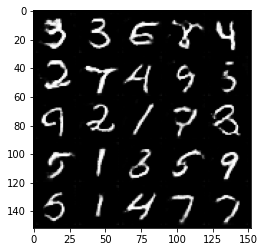

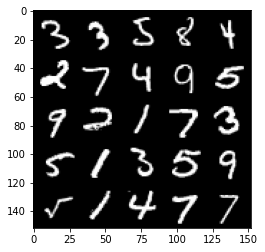

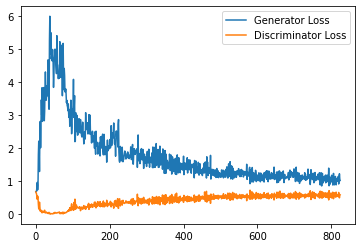

Step 17000: Generator loss: 1.0934299985170364, discriminator loss: 0.5846936501264572


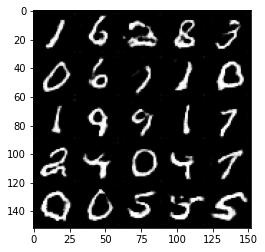

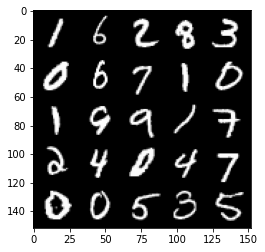

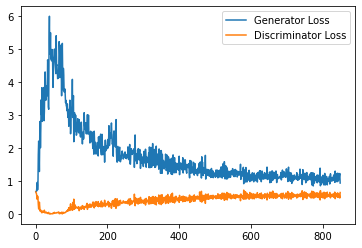

Step 17500: Generator loss: 1.085128982424736, discriminator loss: 0.5853294083476066


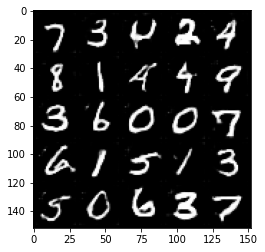

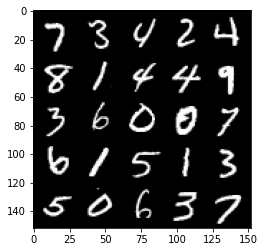

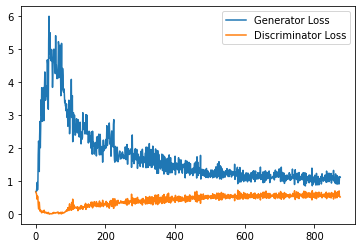

Step 18000: Generator loss: 1.0544736633300782, discriminator loss: 0.5933155034780502


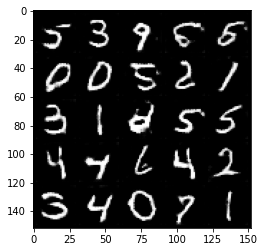

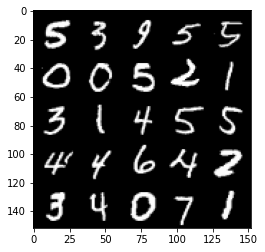

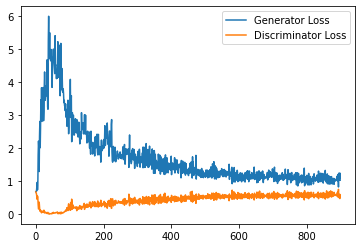

Step 18500: Generator loss: 1.0650811508893967, discriminator loss: 0.5923865246176719


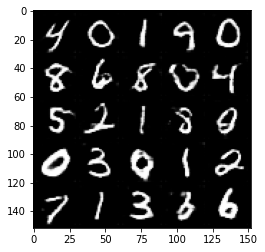

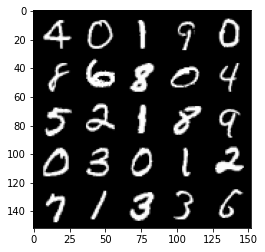

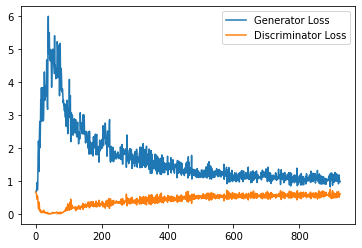

Step 19000: Generator loss: 1.0494329425096511, discriminator loss: 0.5867617886066436


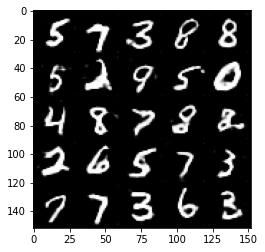

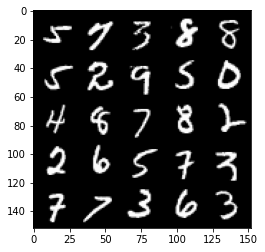

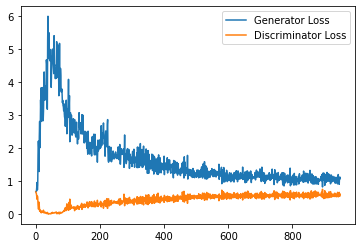

Step 19500: Generator loss: 1.0317058643102646, discriminator loss: 0.5912108282446862


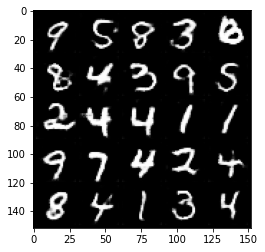

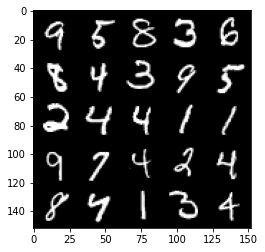

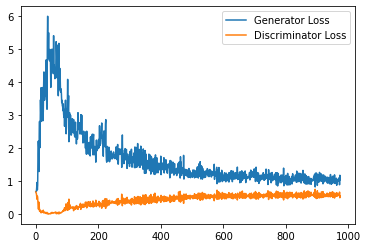

Step 20000: Generator loss: 1.0104954917430877, discriminator loss: 0.592316175699234


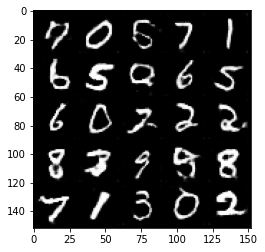

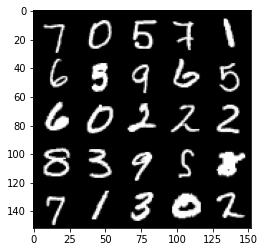

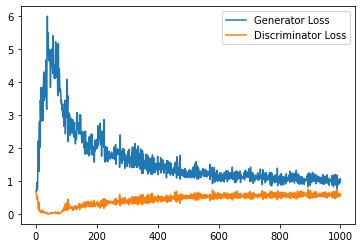

Step 20500: Generator loss: 1.0440653198957444, discriminator loss: 0.5895308622717857


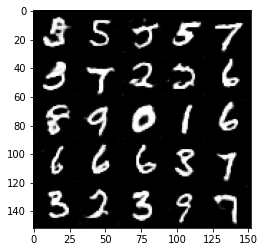

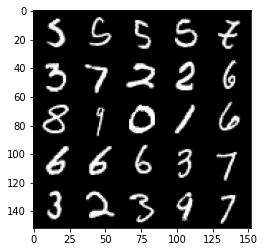

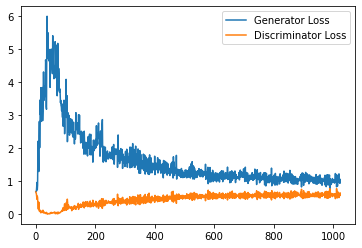

Step 21000: Generator loss: 1.022627964258194, discriminator loss: 0.5924031907916069


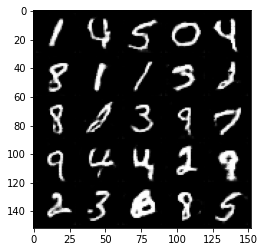

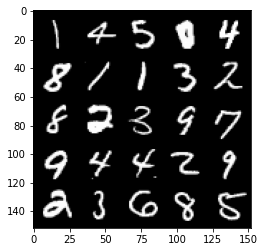

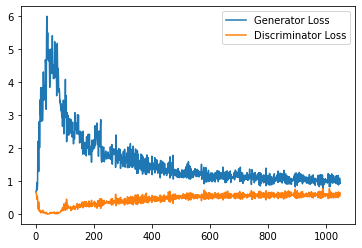

Step 21500: Generator loss: 1.0156051462888718, discriminator loss: 0.5899327756166458


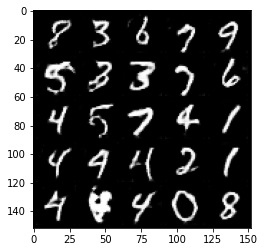

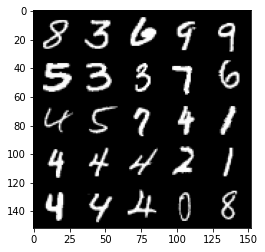

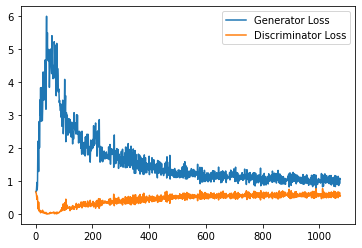

Step 22000: Generator loss: 1.0238373391628266, discriminator loss: 0.5948496541380882


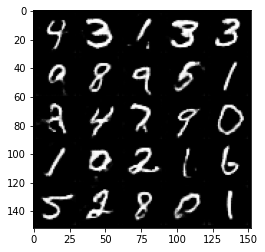

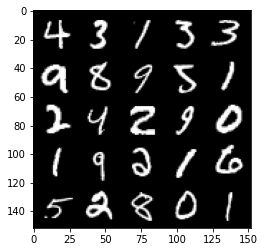

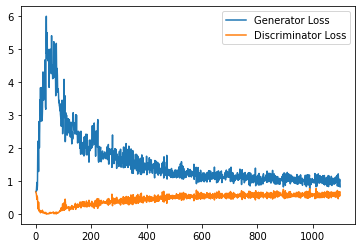

Step 22500: Generator loss: 1.0143587074279785, discriminator loss: 0.604153018951416


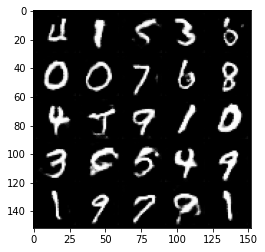

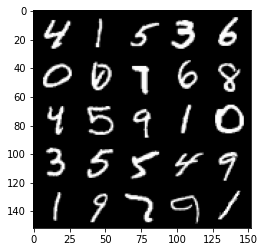

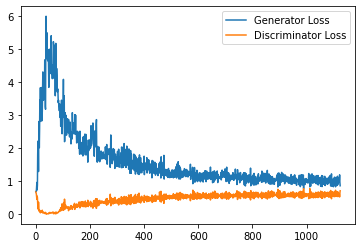

Step 23000: Generator loss: 1.0425254487991333, discriminator loss: 0.6018279309868813


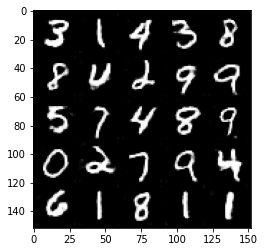

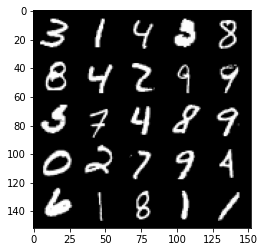

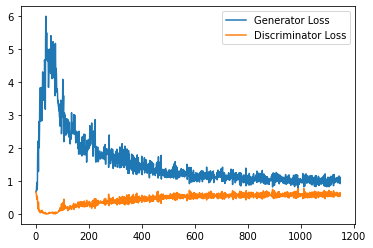

Step 23500: Generator loss: 1.0105416885614396, discriminator loss: 0.5992821697592735


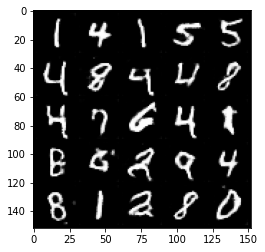

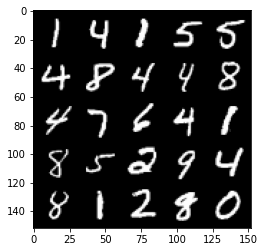

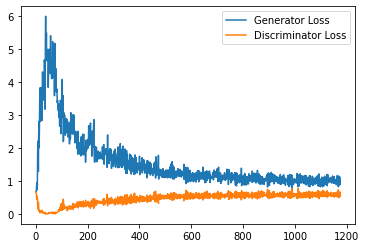

Step 24000: Generator loss: 0.9606515355110169, discriminator loss: 0.6034905700087547


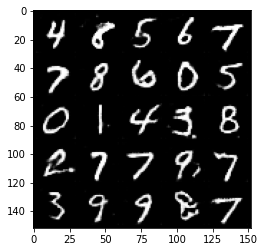

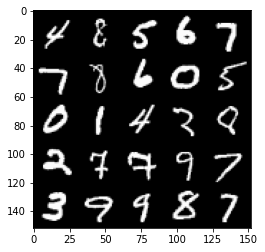

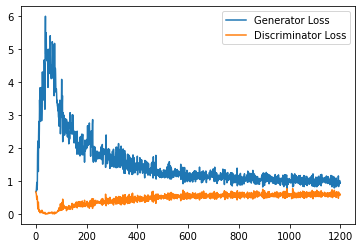

Step 24500: Generator loss: 0.9846826283931732, discriminator loss: 0.6031921647787094


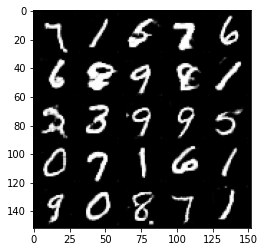

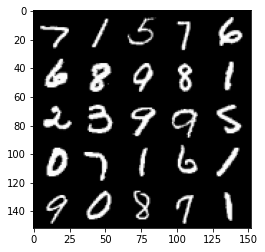

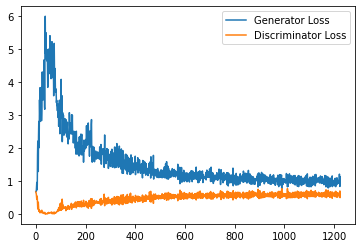

Step 25000: Generator loss: 1.001291640639305, discriminator loss: 0.6030654162168503


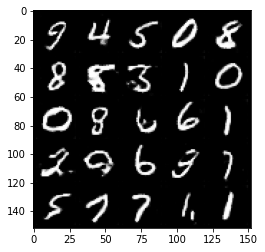

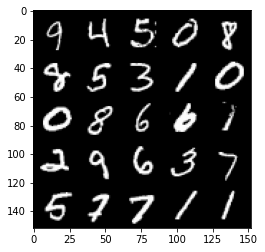

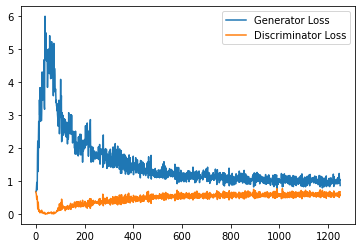

Step 25500: Generator loss: 0.9837488481998443, discriminator loss: 0.6028741301894188


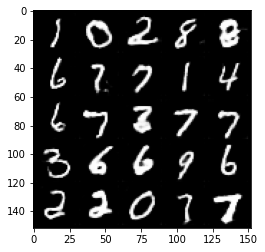

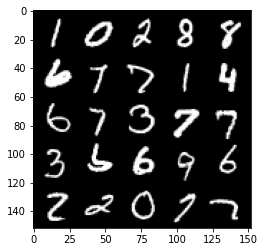

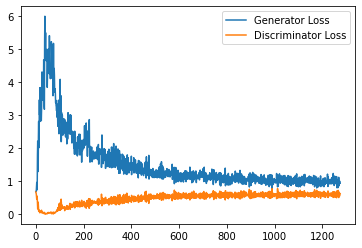

Step 26000: Generator loss: 0.9775775312185288, discriminator loss: 0.6059593797922135


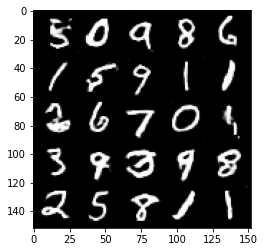

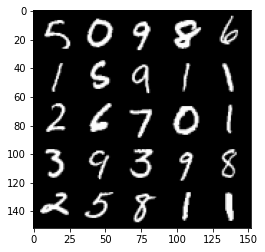

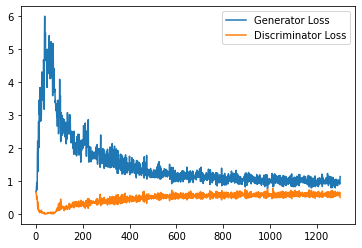

Step 26500: Generator loss: 0.9772804533243179, discriminator loss: 0.6130608657598495


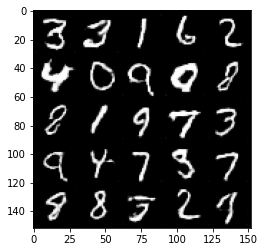

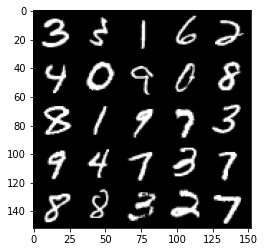

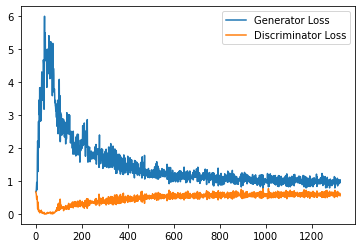

Step 27000: Generator loss: 0.9966835374832154, discriminator loss: 0.6067128828763961


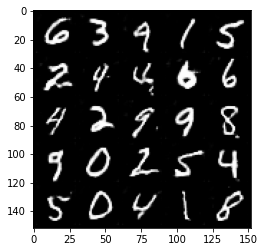

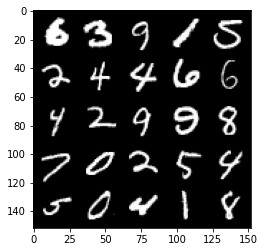

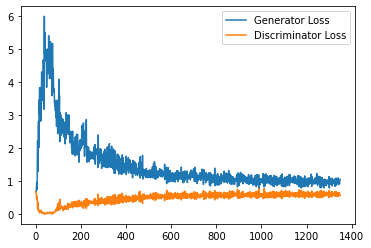

Step 27500: Generator loss: 0.9676104720830917, discriminator loss: 0.6149910229444504


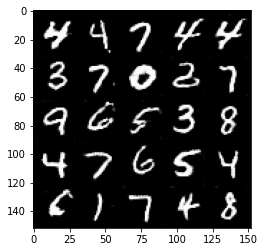

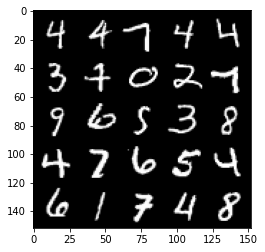

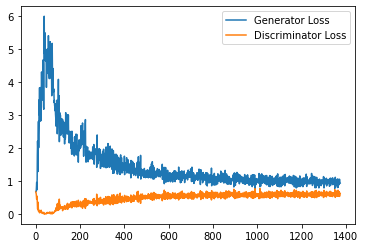

Step 28000: Generator loss: 0.9840296632051468, discriminator loss: 0.6127727352380753


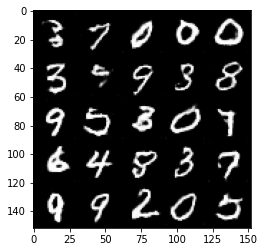

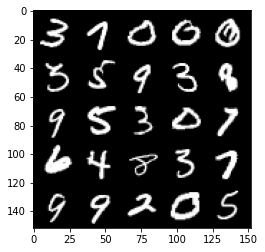

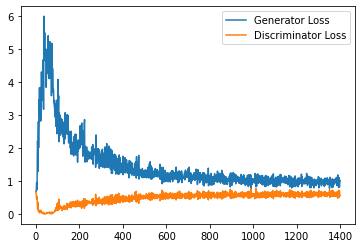

Step 28500: Generator loss: 0.9661336246728897, discriminator loss: 0.6119229528307915


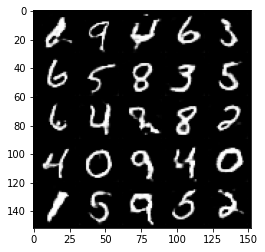

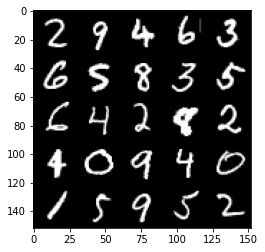

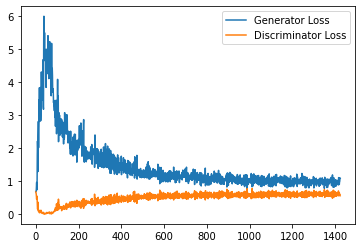

Step 29000: Generator loss: 0.9406558430194855, discriminator loss: 0.6183622370362282


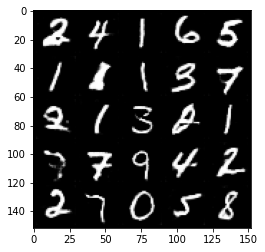

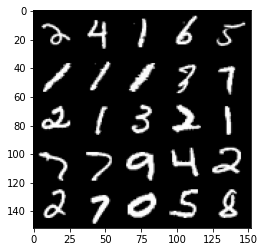

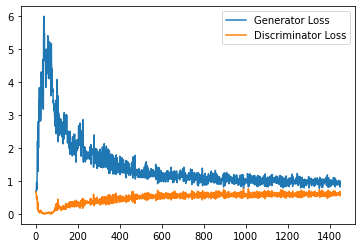

Step 29500: Generator loss: 0.9387636259794235, discriminator loss: 0.6169509020447731


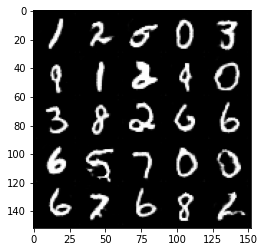

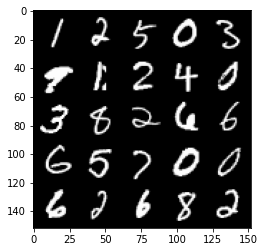

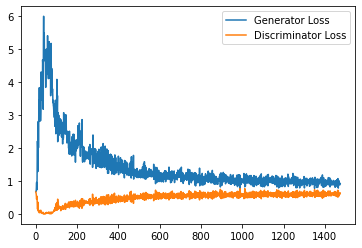

Step 30000: Generator loss: 0.9539812026023865, discriminator loss: 0.6161156675815582


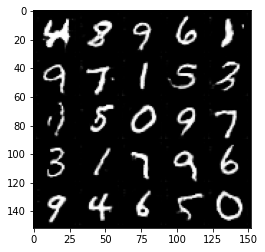

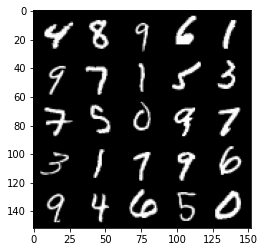

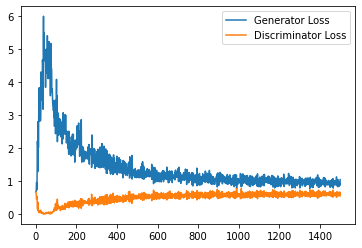

Step 30500: Generator loss: 0.9451723909378051, discriminator loss: 0.6180517992377281


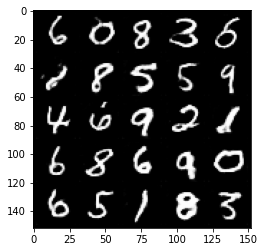

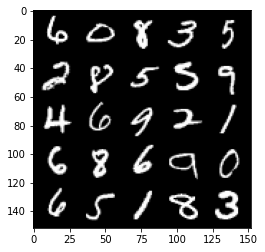

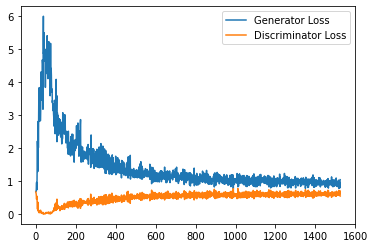

Step 31000: Generator loss: 0.9393131322860718, discriminator loss: 0.6221842265129089


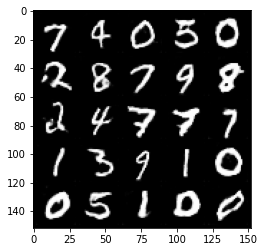

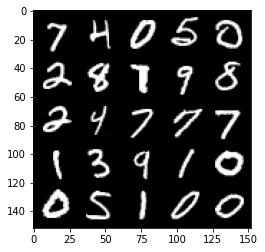

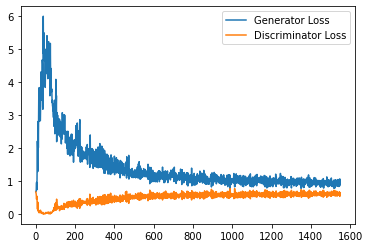

Step 31500: Generator loss: 0.9410091416835785, discriminator loss: 0.6161754704713821


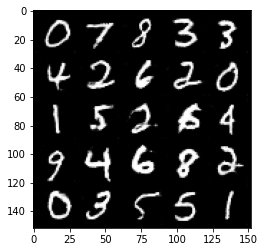

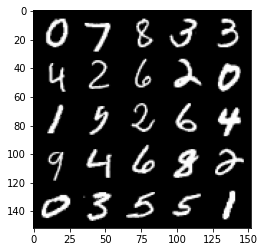

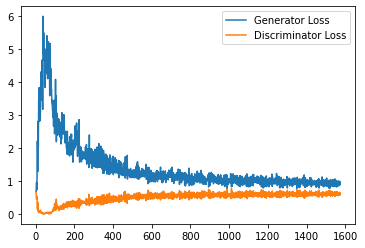

Step 32000: Generator loss: 0.9829701076745987, discriminator loss: 0.6156268041133881


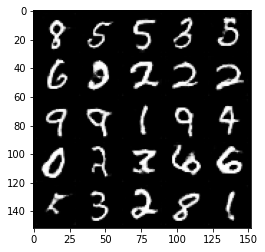

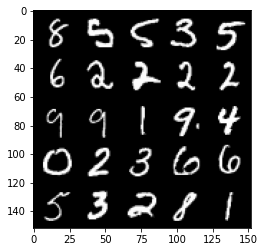

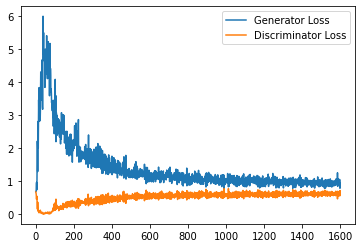

Step 32500: Generator loss: 0.9496131265163421, discriminator loss: 0.6157908108830452


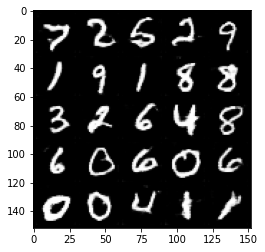

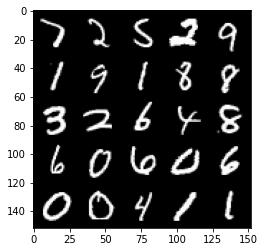

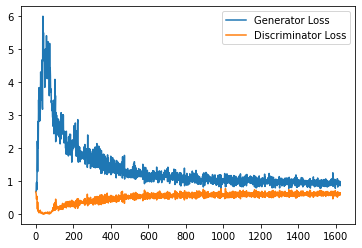

Step 33000: Generator loss: 0.9480036330223084, discriminator loss: 0.6177773116827011


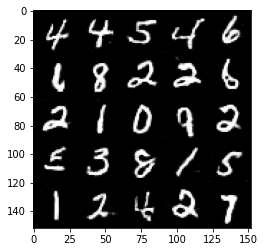

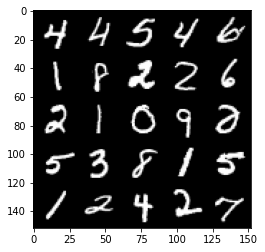

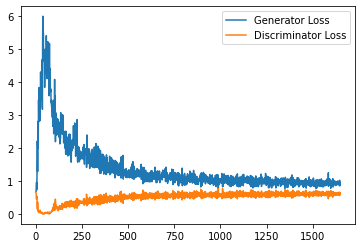

Step 33500: Generator loss: 0.9404569364786148, discriminator loss: 0.6210133266448975


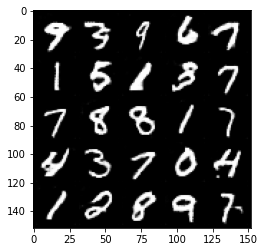

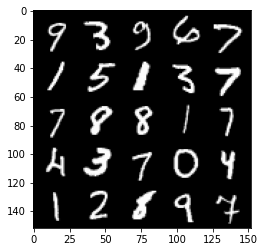

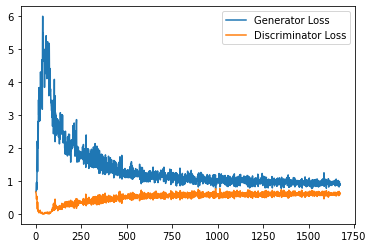

Step 34000: Generator loss: 0.9301774969100952, discriminator loss: 0.6165892341136933


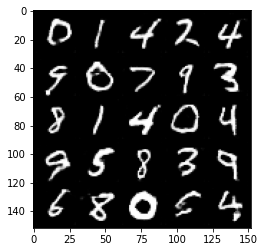

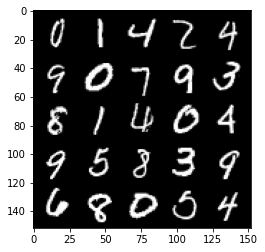

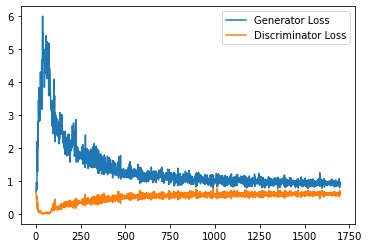

Step 34500: Generator loss: 1.002493969321251, discriminator loss: 0.6112592201828957


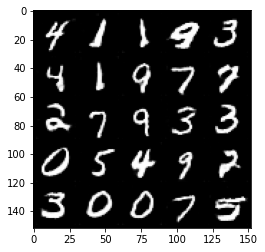

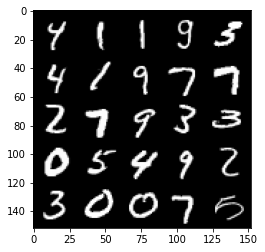

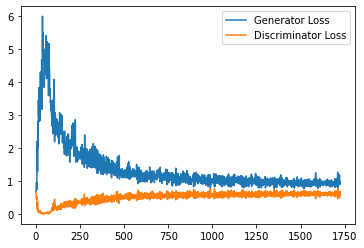

Step 35000: Generator loss: 0.9541755331754684, discriminator loss: 0.6218266693949699


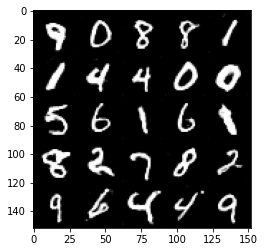

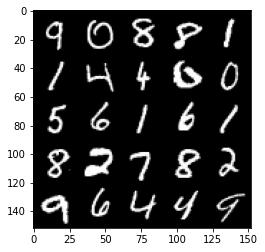

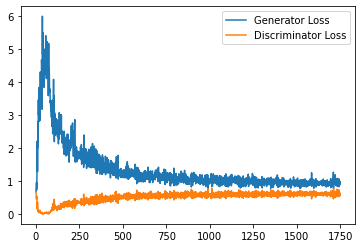

Step 35500: Generator loss: 0.9421331064701081, discriminator loss: 0.6220660883784294


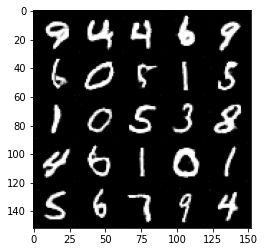

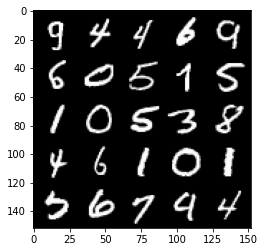

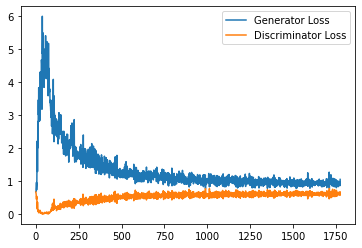

Step 36000: Generator loss: 0.9373998200893402, discriminator loss: 0.6155880821347237


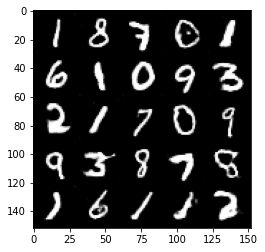

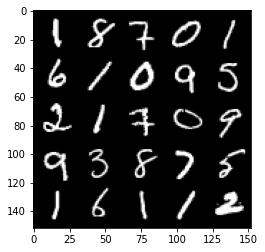

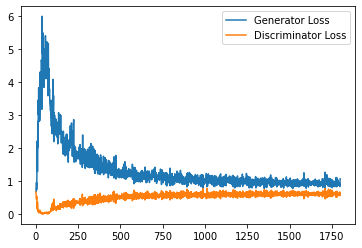

Step 36500: Generator loss: 0.9613726609945297, discriminator loss: 0.6139992454648018


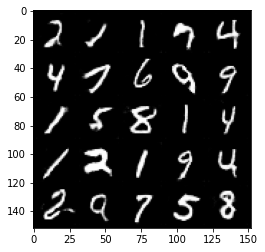

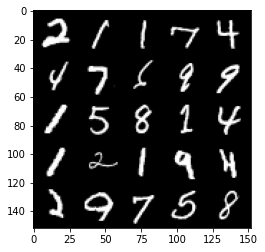

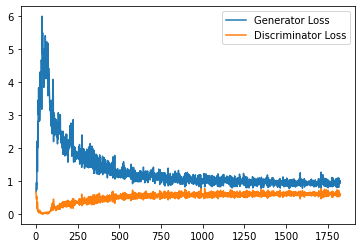

Step 37000: Generator loss: 0.9679521949291229, discriminator loss: 0.6159950734376908


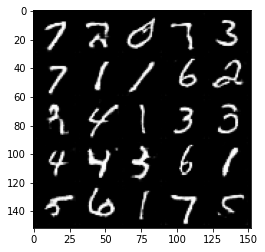

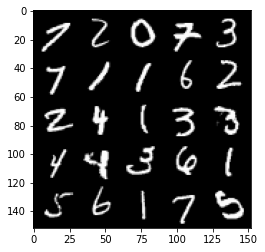

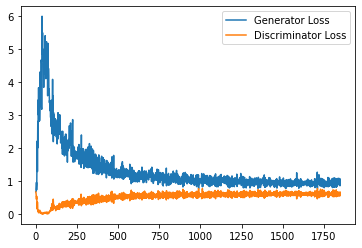

Step 37500: Generator loss: 0.9453995475769043, discriminator loss: 0.6185813305377961


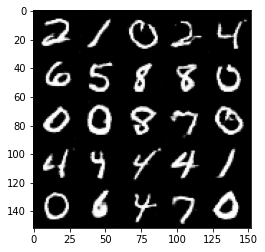

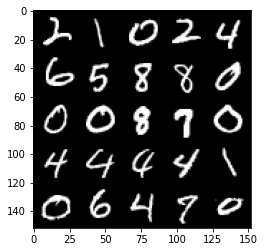

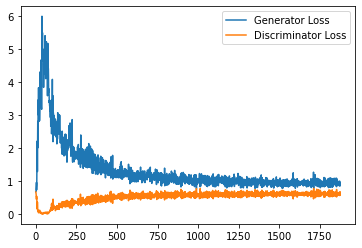

Step 38000: Generator loss: 0.9507176909446716, discriminator loss: 0.6161811894178391


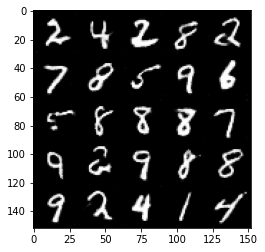

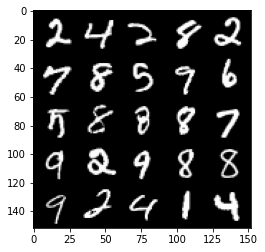

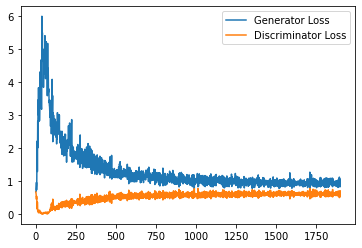

Step 38500: Generator loss: 0.9544829740524292, discriminator loss: 0.610461654484272


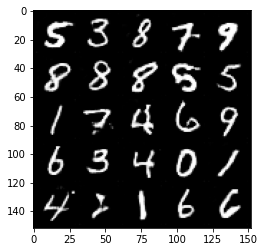

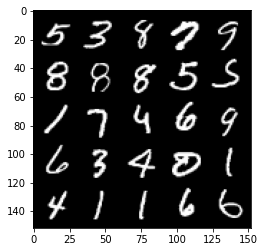

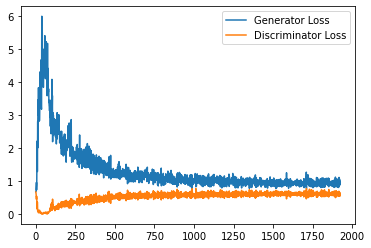

Step 39000: Generator loss: 0.9389196572303772, discriminator loss: 0.6171172871589661


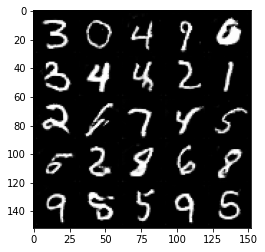

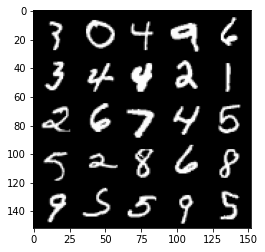

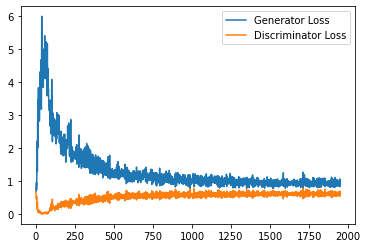

Step 39500: Generator loss: 0.992310494184494, discriminator loss: 0.6167204930186272


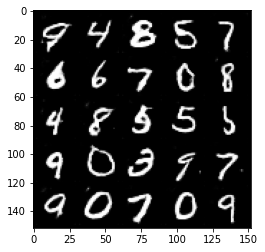

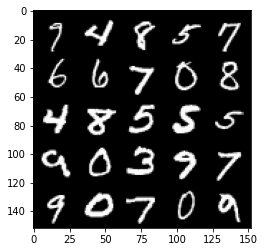

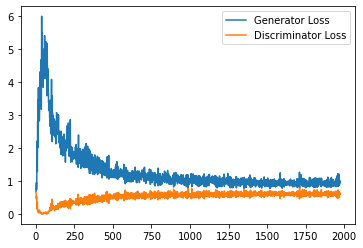

Step 40000: Generator loss: 0.9633839410543442, discriminator loss: 0.6156242870688439


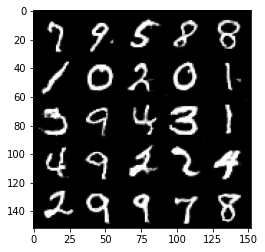

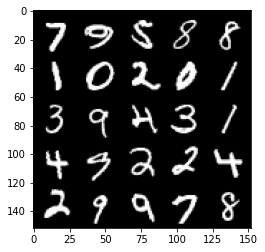

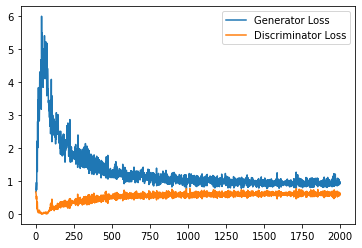

Step 40500: Generator loss: 0.9603834257125855, discriminator loss: 0.6140371487140656


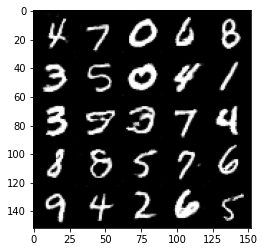

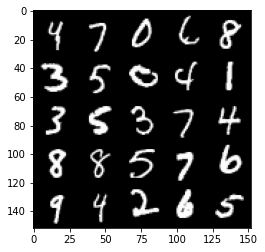

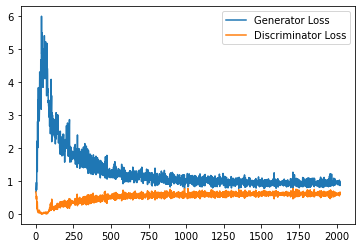

Step 41000: Generator loss: 1.0033880851268768, discriminator loss: 0.6083020213246345


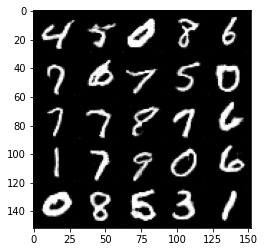

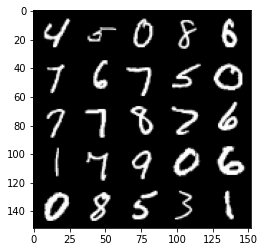

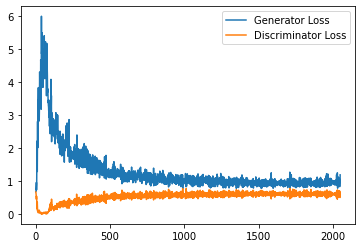

Step 41500: Generator loss: 0.9635097402334213, discriminator loss: 0.614170391857624


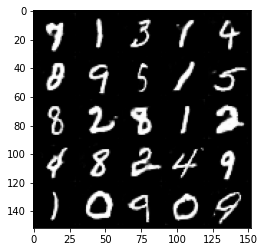

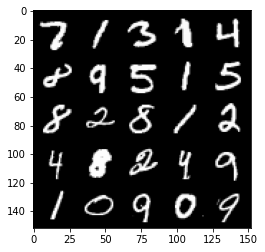

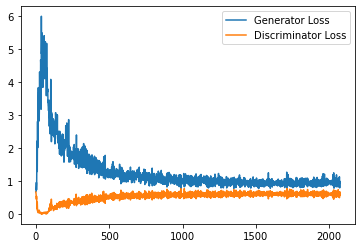

Step 42000: Generator loss: 0.9472184504270553, discriminator loss: 0.6158808542490005


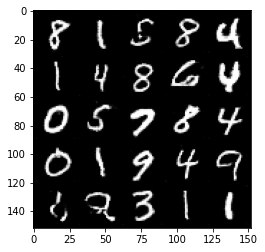

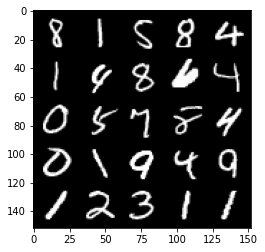

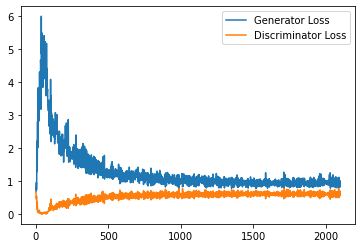

Step 42500: Generator loss: 0.9664274554252624, discriminator loss: 0.6069545133113861


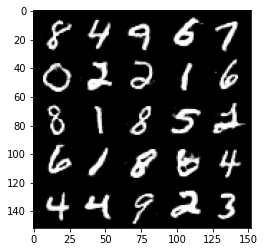

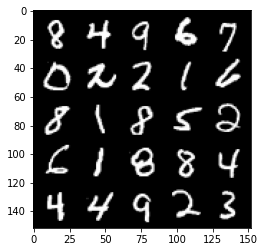

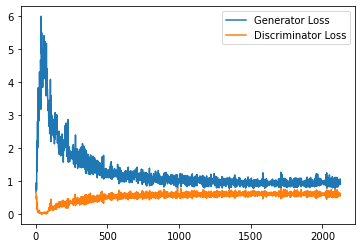

Step 43000: Generator loss: 0.9528260935544968, discriminator loss: 0.610894719004631


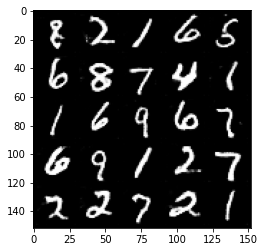

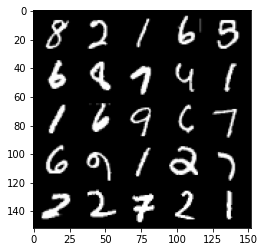

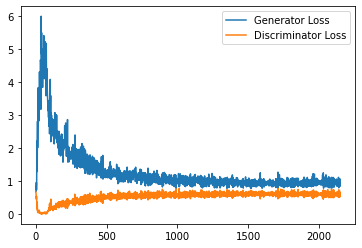

Step 43500: Generator loss: 0.9601508436203003, discriminator loss: 0.6075107179880143


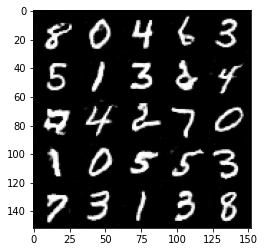

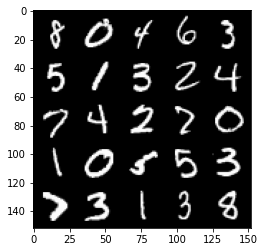

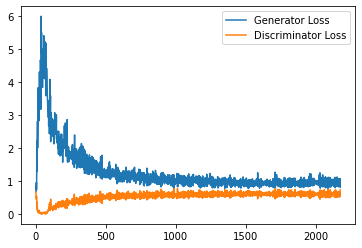

Step 44000: Generator loss: 0.9772930108308792, discriminator loss: 0.6005250564813613


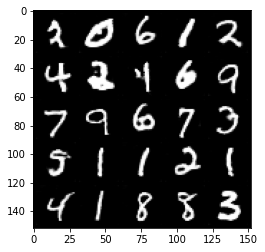

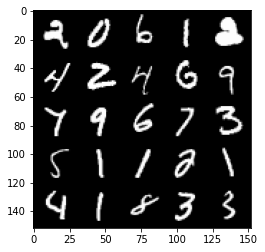

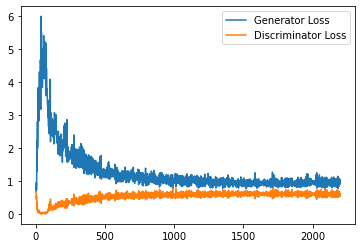

Step 44500: Generator loss: 0.9564793837070465, discriminator loss: 0.6079455219507217


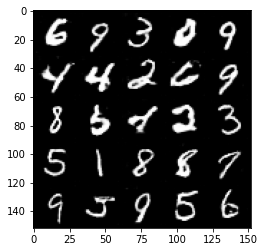

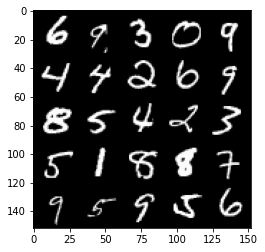

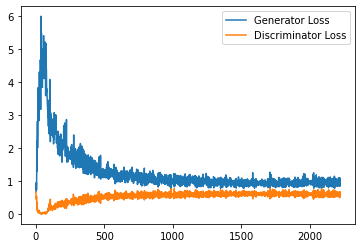

Step 45000: Generator loss: 0.978757095694542, discriminator loss: 0.6049366927742958


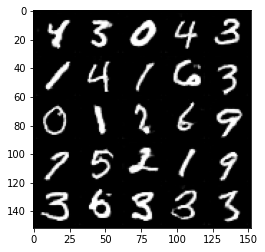

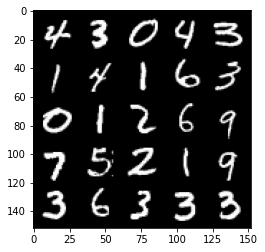

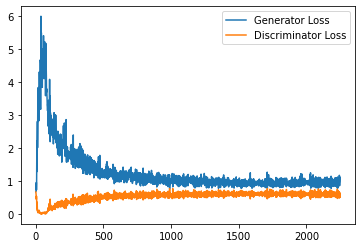

Step 45500: Generator loss: 0.9585891975164413, discriminator loss: 0.6085563035011291


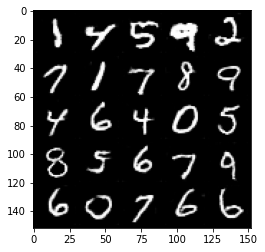

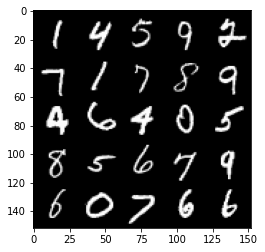

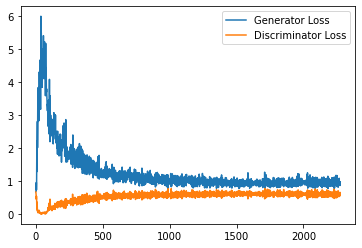

Step 46000: Generator loss: 0.9608872385025025, discriminator loss: 0.609534224152565


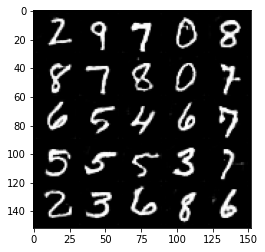

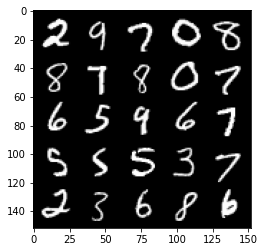

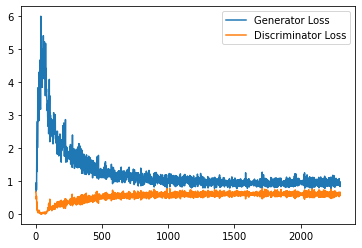

Step 46500: Generator loss: 0.9752284867763519, discriminator loss: 0.6051716564893722


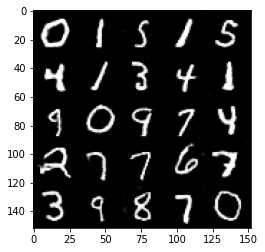

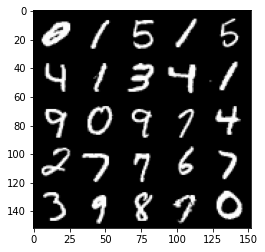

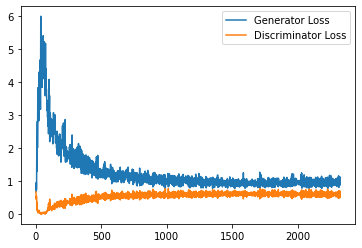

Step 47000: Generator loss: 0.9696032803058624, discriminator loss: 0.6108252619504928


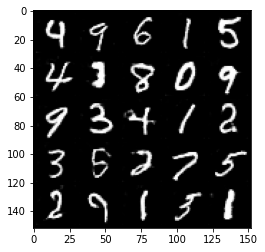

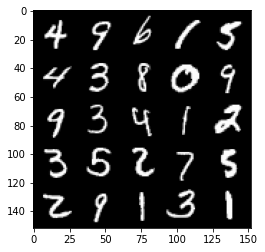

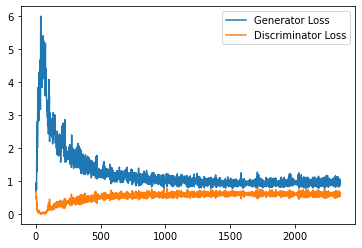

Step 47500: Generator loss: 0.9561639656424522, discriminator loss: 0.6039803940653801


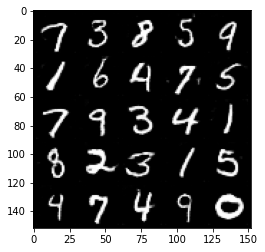

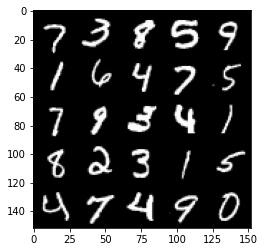

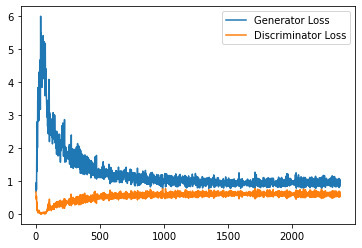

Step 48000: Generator loss: 0.9478838702440262, discriminator loss: 0.6058535527586937


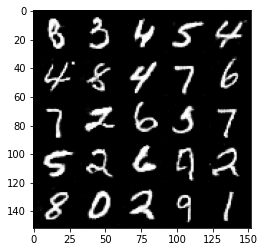

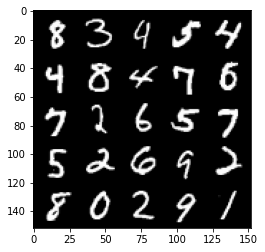

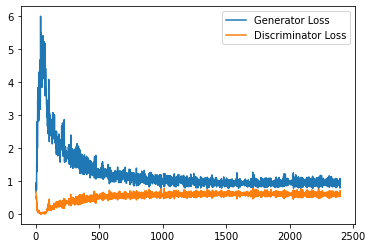

Step 48500: Generator loss: 1.0065301209688187, discriminator loss: 0.6052980086803437


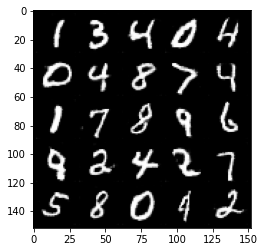

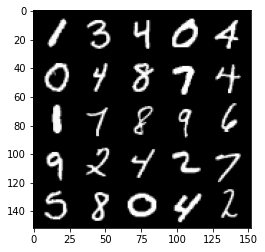

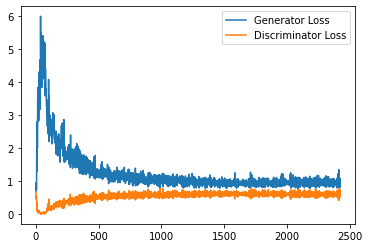

Step 49000: Generator loss: 0.9672621754407883, discriminator loss: 0.6015041060447693


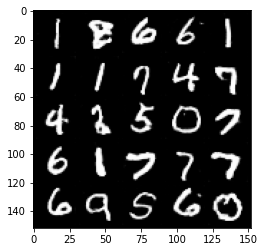

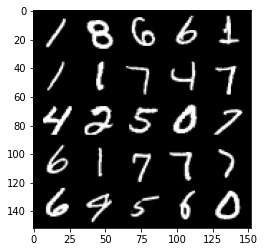

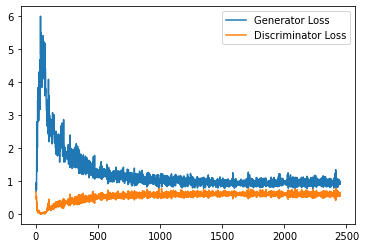

Step 49500: Generator loss: 0.9729993258714675, discriminator loss: 0.5965852686762809


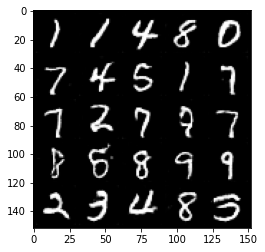

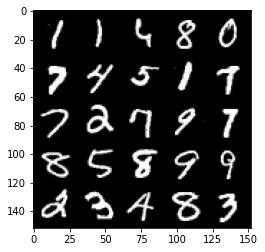

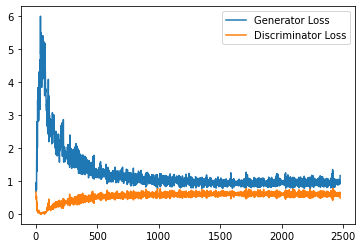

Step 50000: Generator loss: 0.9913670601844787, discriminator loss: 0.6057579455375671


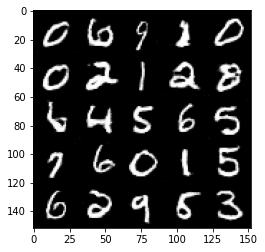

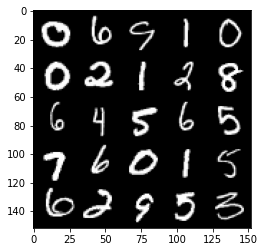

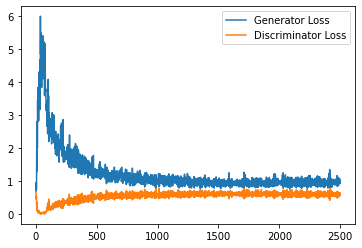

Step 50500: Generator loss: 0.9750005136728287, discriminator loss: 0.5999209277629852


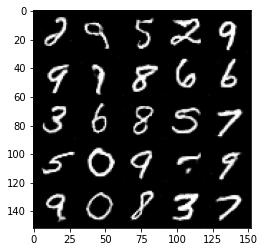

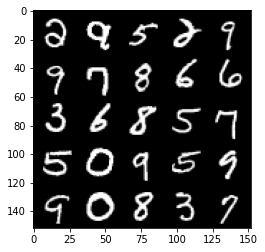

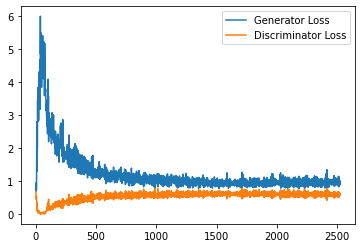

Step 51000: Generator loss: 0.9605884938240051, discriminator loss: 0.5939586407542229


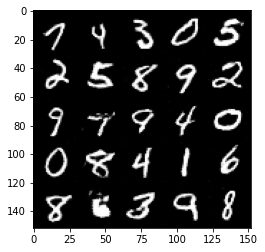

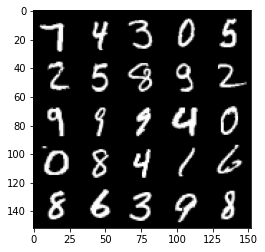

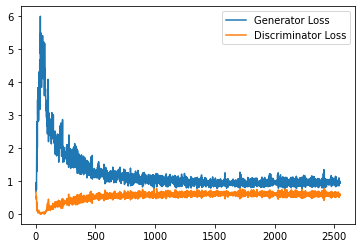

Step 51500: Generator loss: 0.9956928368806839, discriminator loss: 0.5928382208943367


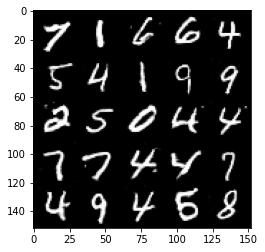

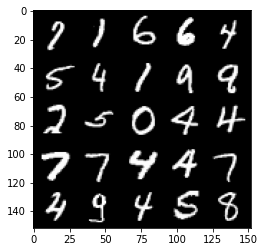

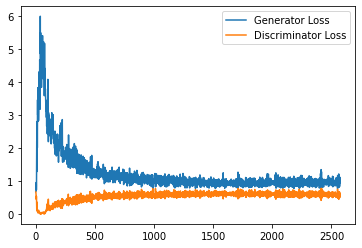

Step 52000: Generator loss: 0.9760257906913757, discriminator loss: 0.5948214864730835


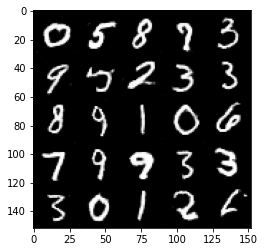

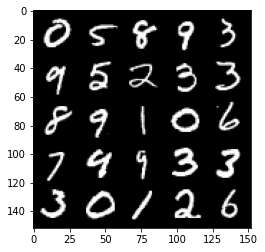

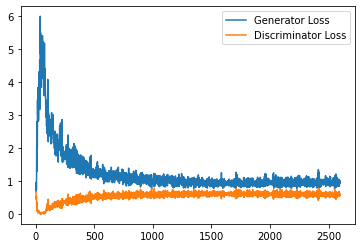

Step 52500: Generator loss: 0.9719528957605362, discriminator loss: 0.6018025313019753


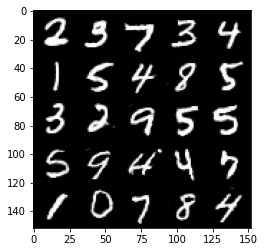

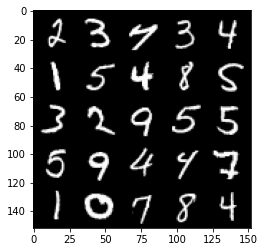

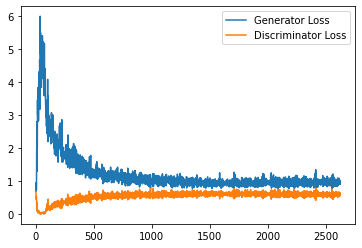

Step 53000: Generator loss: 1.0017710633277892, discriminator loss: 0.5900089066624642


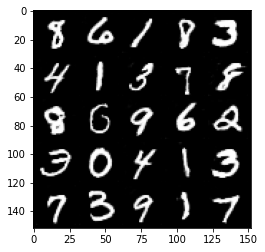

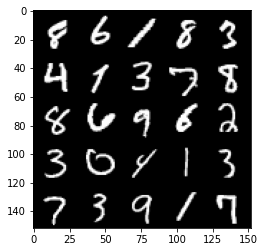

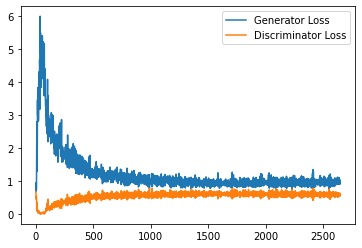

Step 53500: Generator loss: 0.9680878194570541, discriminator loss: 0.5933358626365661


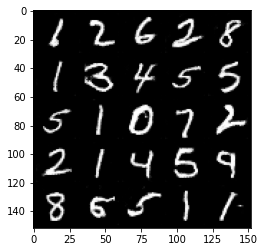

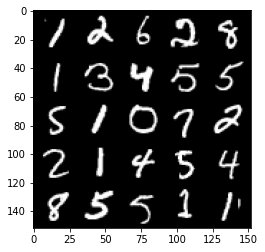

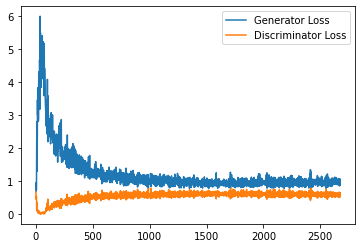

Step 54000: Generator loss: 0.9946532653570175, discriminator loss: 0.5889713744521141


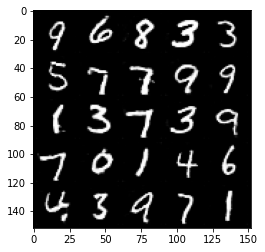

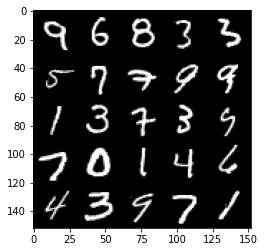

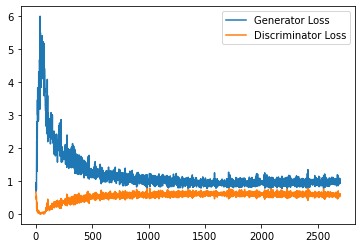

Step 54500: Generator loss: 0.9977187756299972, discriminator loss: 0.5933357434272766


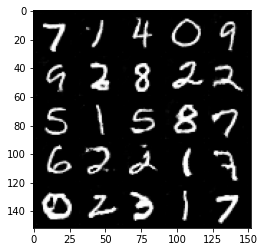

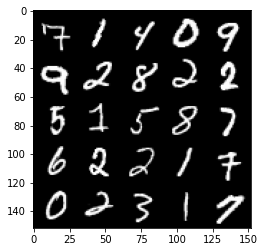

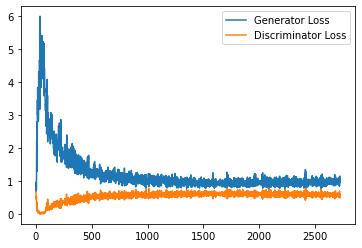

Step 55000: Generator loss: 0.9912464467287063, discriminator loss: 0.5930050192475319


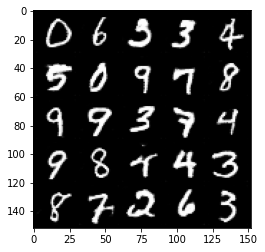

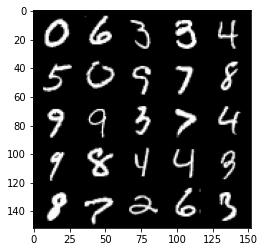

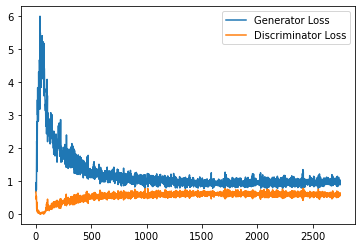

Step 55500: Generator loss: 0.9870397964715958, discriminator loss: 0.5950230666995049


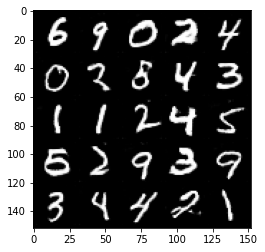

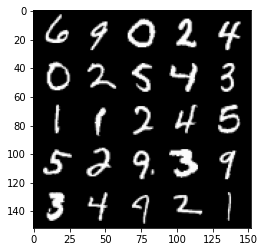

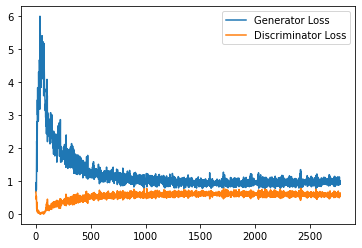

Step 56000: Generator loss: 0.9987527706623077, discriminator loss: 0.585323359310627


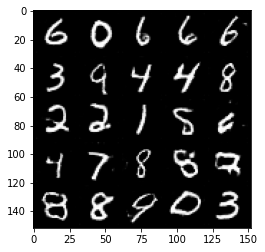

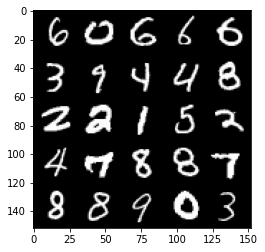

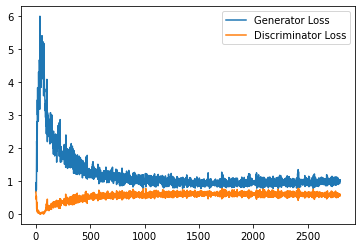

Step 56500: Generator loss: 0.9954652638435364, discriminator loss: 0.5898071724772453


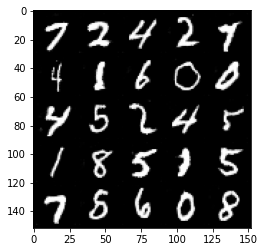

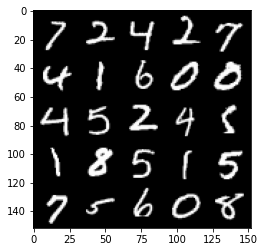

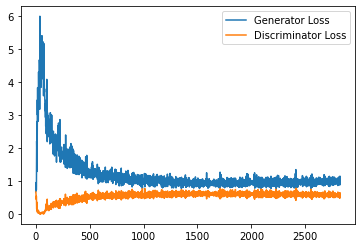

Step 57000: Generator loss: 1.0176063545942307, discriminator loss: 0.5832559397816658


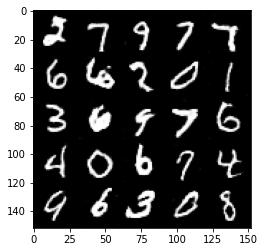

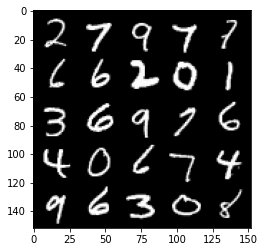

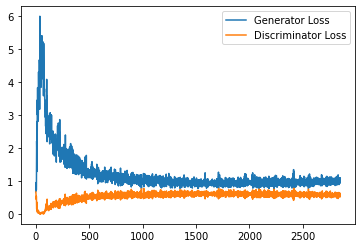

Step 57500: Generator loss: 1.0076931734085084, discriminator loss: 0.5867435005903244


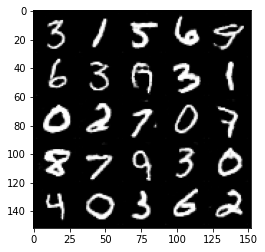

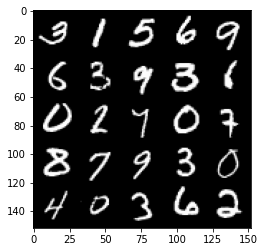

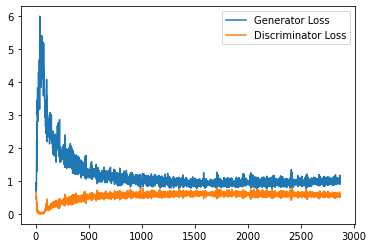

Step 58000: Generator loss: 1.0298826050758363, discriminator loss: 0.5830673757195473


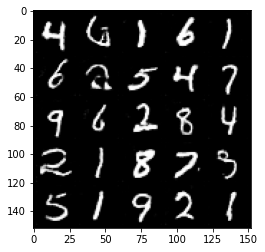

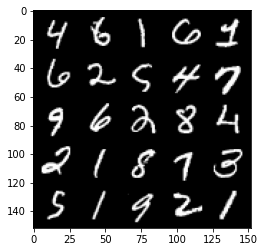

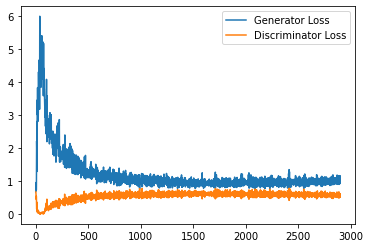

Step 58500: Generator loss: 1.0067320734262466, discriminator loss: 0.5853720976114273


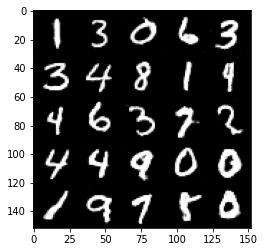

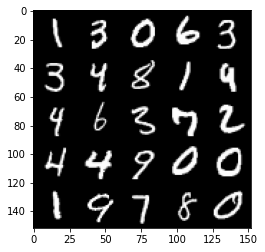

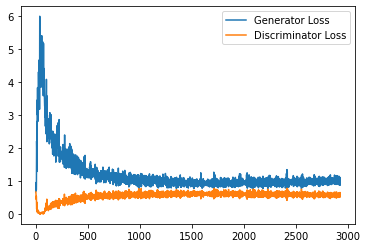

Step 59000: Generator loss: 1.0146182025671004, discriminator loss: 0.5883903267383576


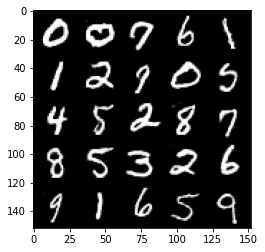

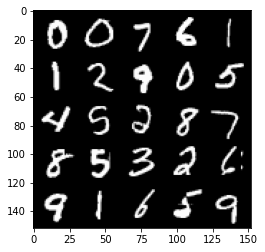

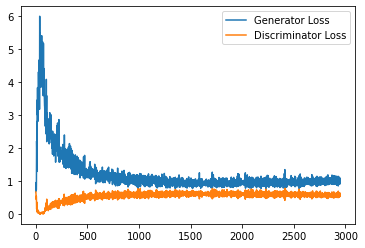

Step 59500: Generator loss: 1.0285444859266282, discriminator loss: 0.5843225317001343


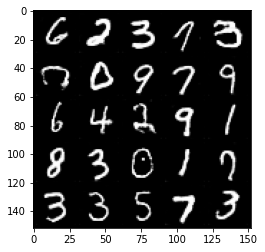

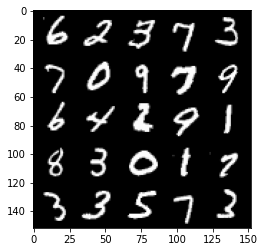

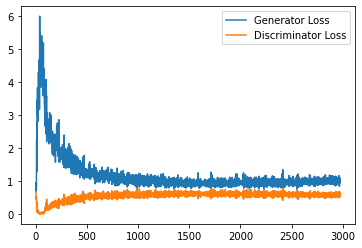

Step 60000: Generator loss: 1.015925794005394, discriminator loss: 0.5794909119606018


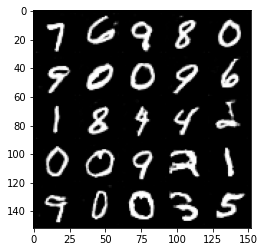

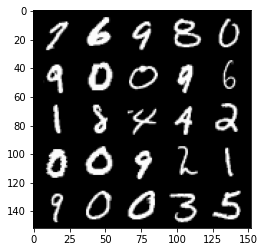

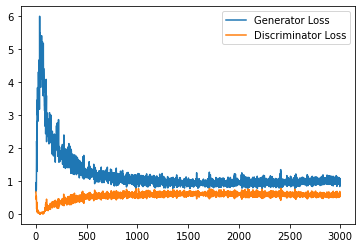

Step 60500: Generator loss: 1.0152023360729217, discriminator loss: 0.5823143793940544


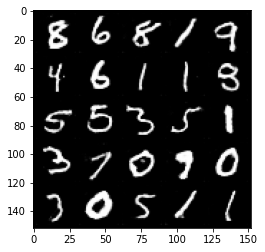

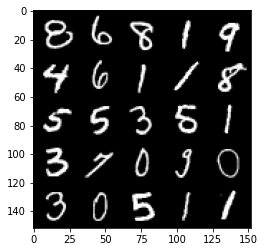

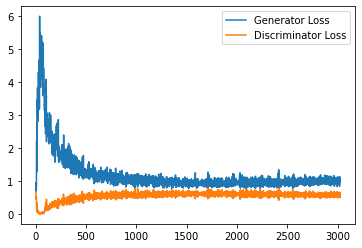

Step 61000: Generator loss: 1.0050697162151336, discriminator loss: 0.583320930659771


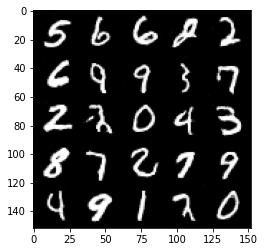

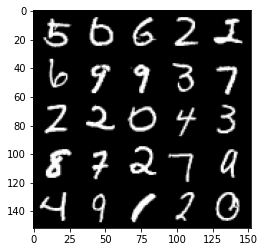

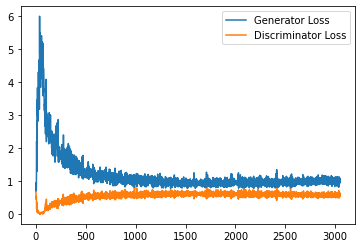

Step 61500: Generator loss: 1.0242693419456481, discriminator loss: 0.5790231913328171


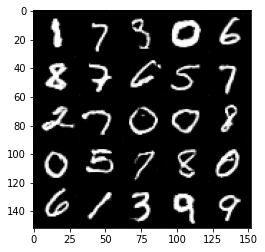

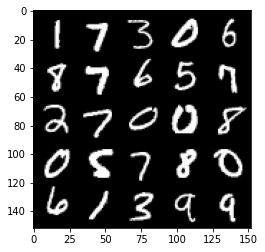

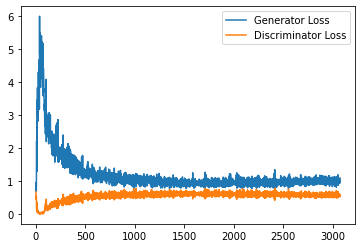

Step 62000: Generator loss: 1.0223616855144502, discriminator loss: 0.5845479247570038


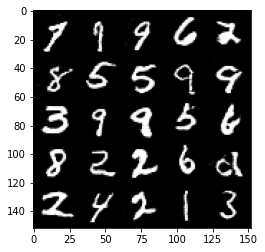

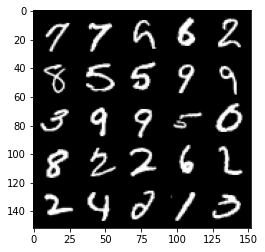

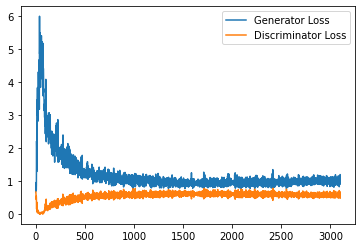

Step 62500: Generator loss: 1.0314220012426376, discriminator loss: 0.5800052870512009


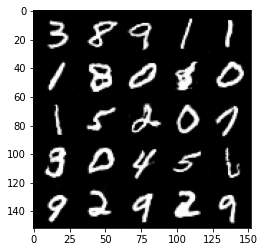

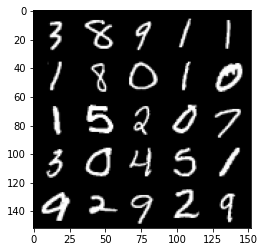

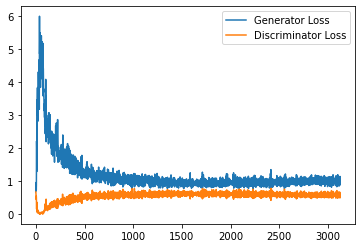

Step 63000: Generator loss: 1.025968349456787, discriminator loss: 0.5765885534882546


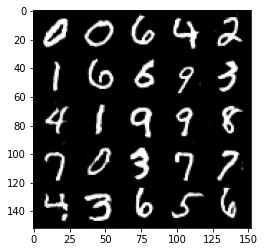

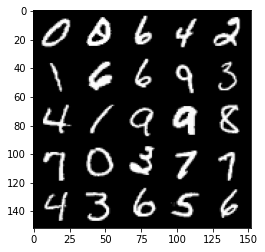

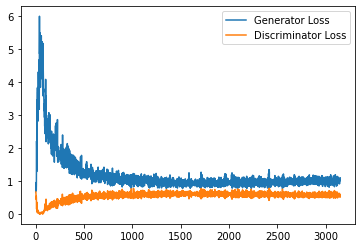

Step 63500: Generator loss: 1.031419030547142, discriminator loss: 0.5828363372683525


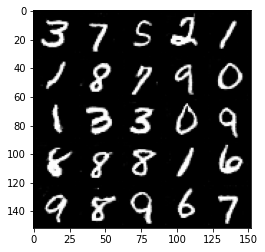

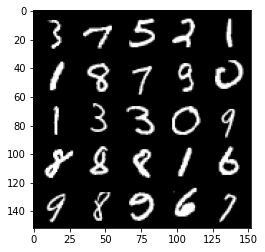

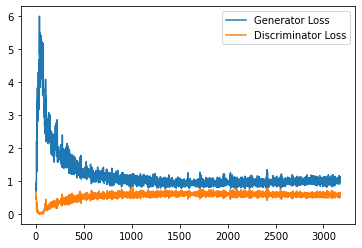

Step 64000: Generator loss: 1.040447160601616, discriminator loss: 0.5816138852238655


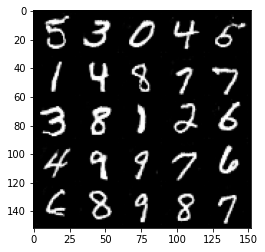

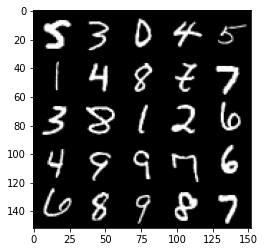

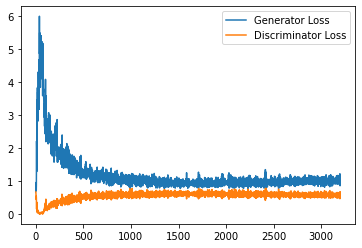

Step 64500: Generator loss: 1.0261724812984467, discriminator loss: 0.576854856133461


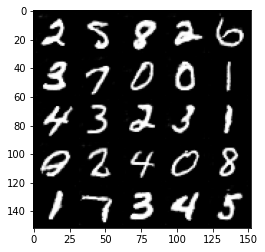

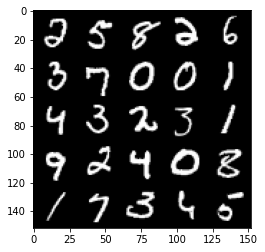

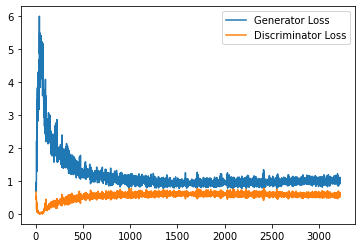

Step 65000: Generator loss: 1.0464040904045104, discriminator loss: 0.578391053378582


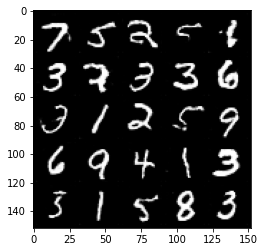

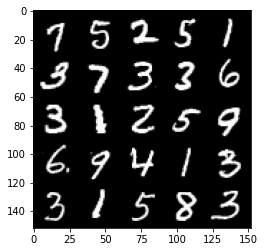

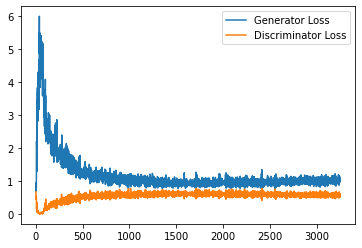

Step 65500: Generator loss: 1.0387887872457504, discriminator loss: 0.5803813529014588


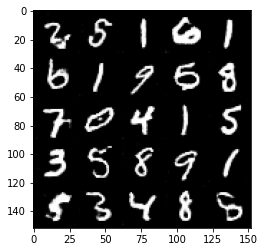

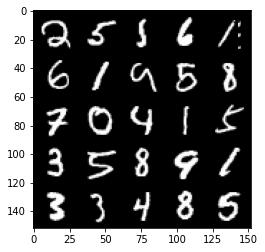

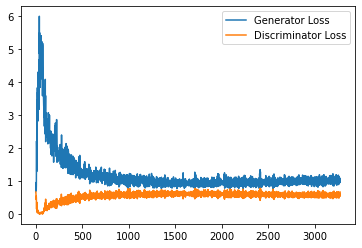

Step 66000: Generator loss: 1.0696742091178895, discriminator loss: 0.5708670071959495


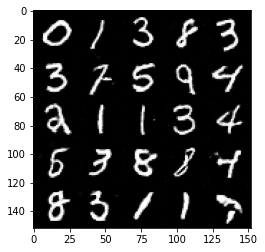

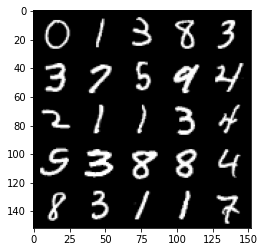

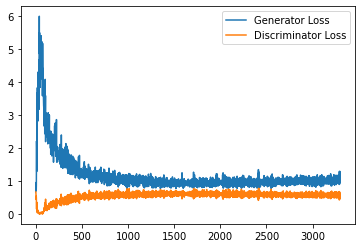

Step 66500: Generator loss: 1.0359663109779358, discriminator loss: 0.5709465634226799


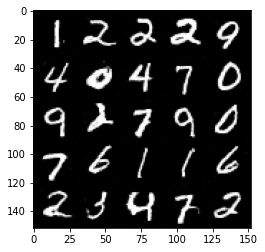

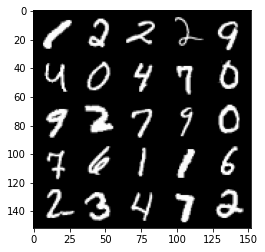

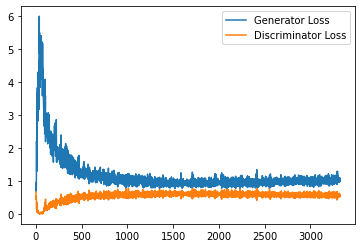

Step 67000: Generator loss: 1.049827453017235, discriminator loss: 0.5746566697359085


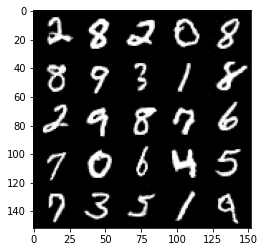

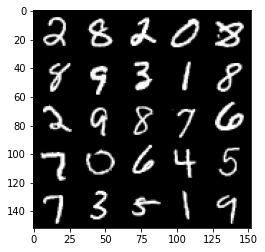

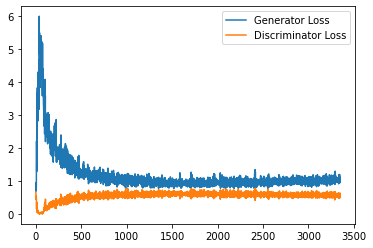

Step 67500: Generator loss: 1.034831364750862, discriminator loss: 0.5738502129912376


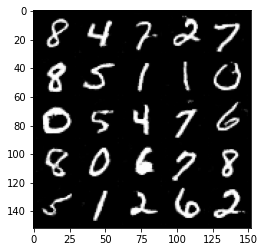

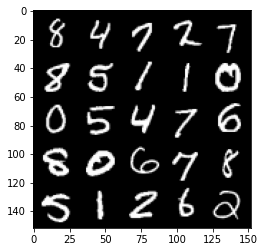

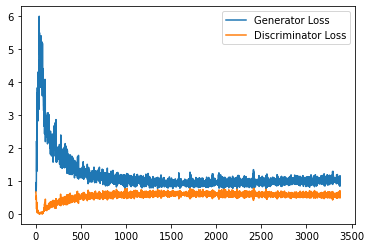

Step 68000: Generator loss: 1.051141687989235, discriminator loss: 0.5757841716408729


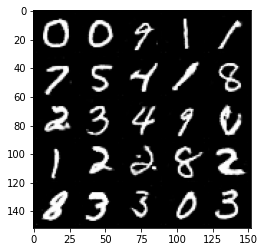

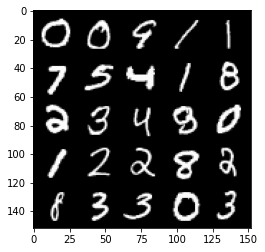

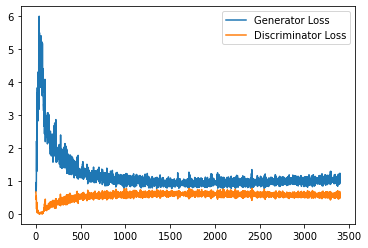

Step 68500: Generator loss: 1.075137349486351, discriminator loss: 0.5724215179681778


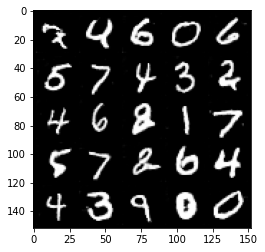

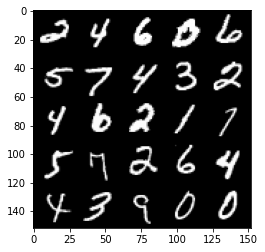

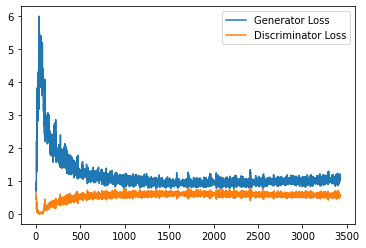

Step 69000: Generator loss: 1.0586089183092118, discriminator loss: 0.5708066313266754


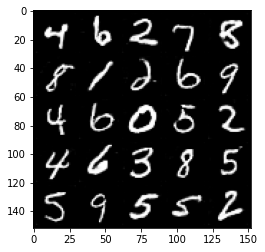

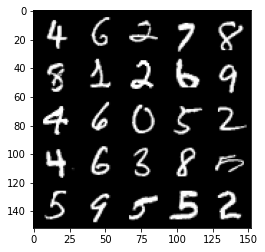

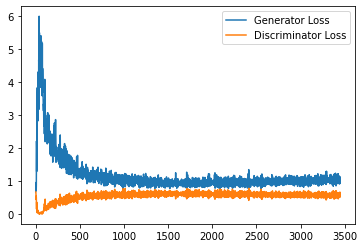

Step 69500: Generator loss: 1.0334146265983581, discriminator loss: 0.568114759862423


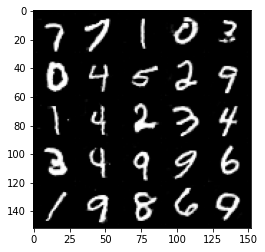

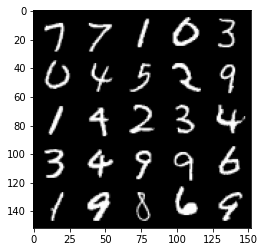

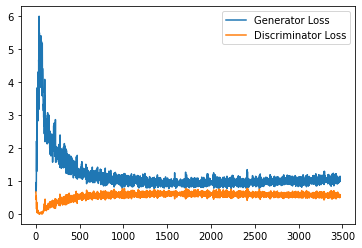

Step 70000: Generator loss: 1.048153720498085, discriminator loss: 0.5724779406189918


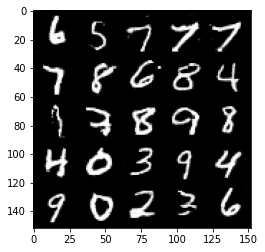

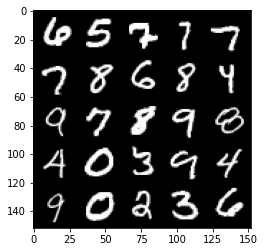

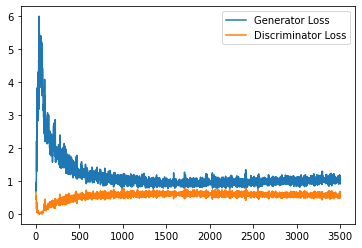

Step 70500: Generator loss: 1.046394855737686, discriminator loss: 0.5704109700322151


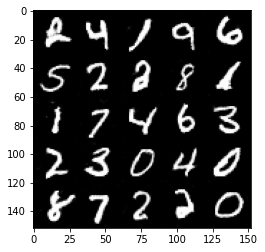

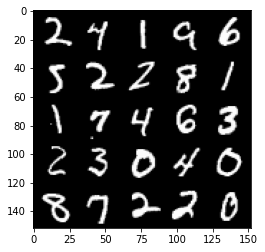

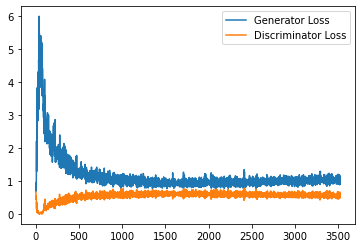

Step 71000: Generator loss: 1.055334347128868, discriminator loss: 0.5648394389748573


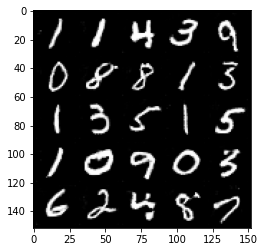

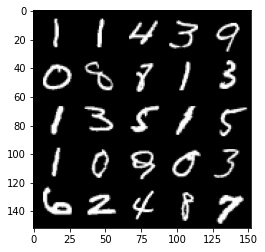

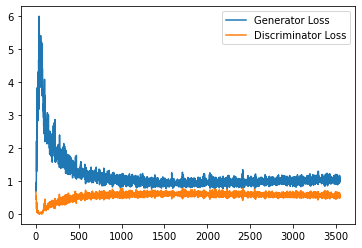

Step 71500: Generator loss: 1.0479205166101455, discriminator loss: 0.5689550558924675


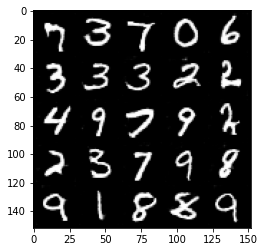

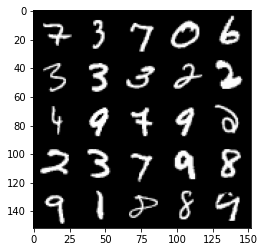

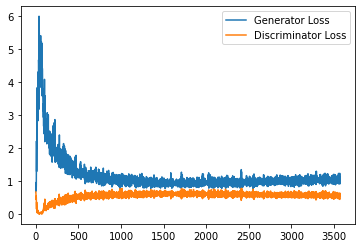

Step 72000: Generator loss: 1.0578684183359146, discriminator loss: 0.5685399363040924


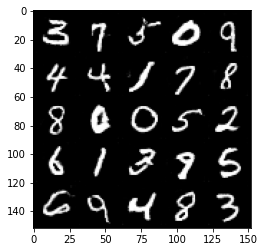

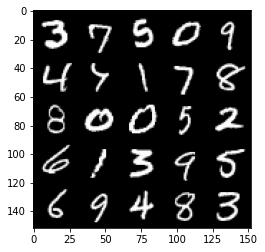

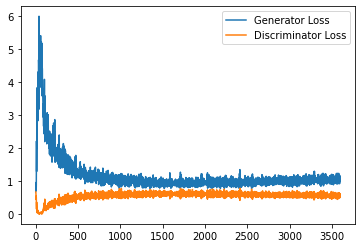

Step 72500: Generator loss: 1.0691917601823806, discriminator loss: 0.5672464718222618


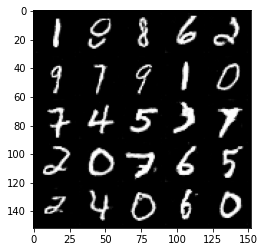

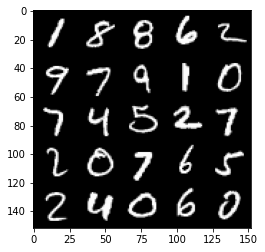

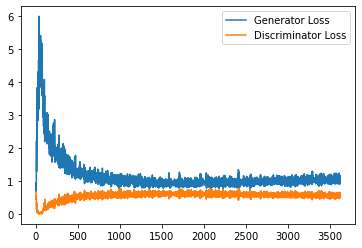

Step 73000: Generator loss: 1.0548255580663681, discriminator loss: 0.5684518122076988


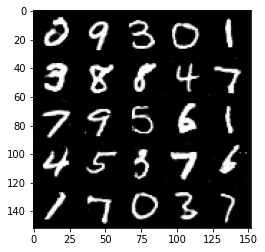

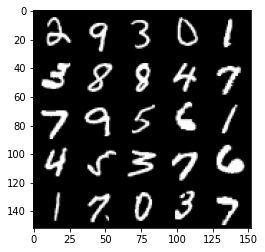

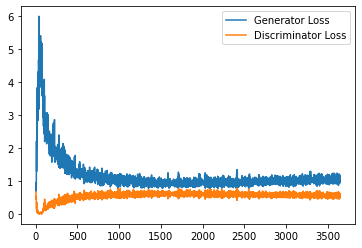

Step 73500: Generator loss: 1.0797411249876023, discriminator loss: 0.5688797743916512


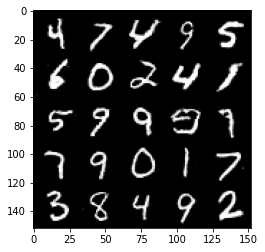

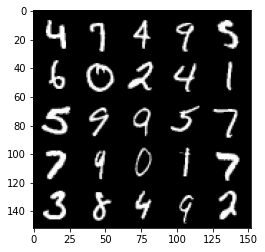

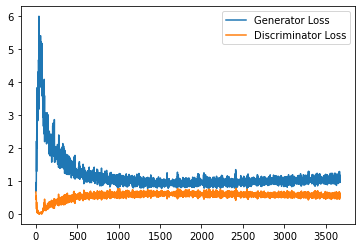

Step 74000: Generator loss: 1.071800403356552, discriminator loss: 0.5693561809659005


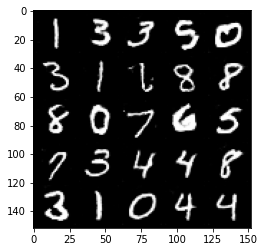

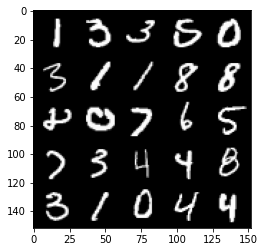

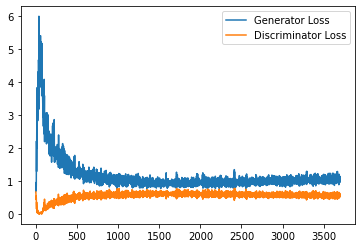

Step 74500: Generator loss: 1.0648247705698013, discriminator loss: 0.5677209900617599


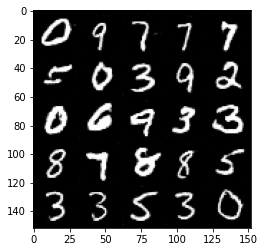

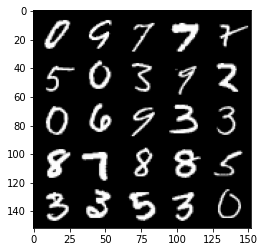

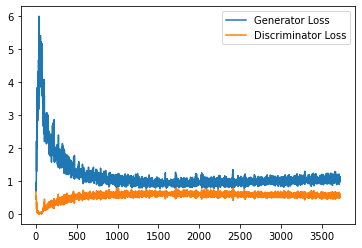

Step 75000: Generator loss: 1.0704360243082047, discriminator loss: 0.5726254461407662


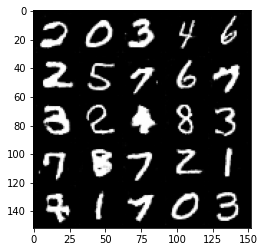

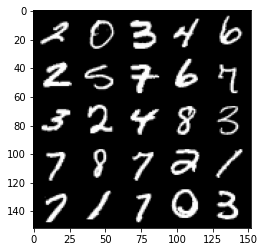

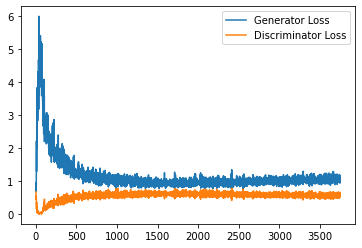

Step 75500: Generator loss: 1.071861621260643, discriminator loss: 0.5731110416054725


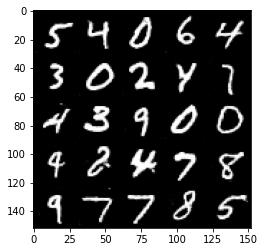

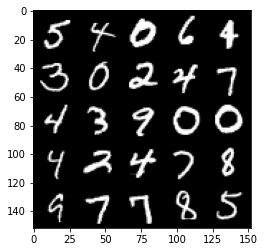

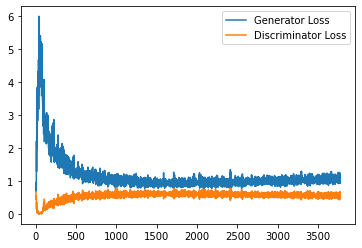

Step 76000: Generator loss: 1.0638036302328109, discriminator loss: 0.5725631821155548


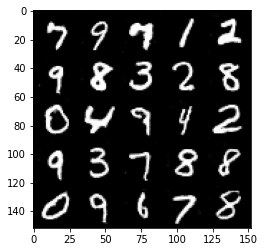

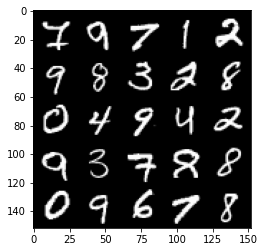

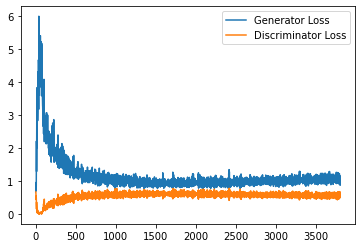

Step 76500: Generator loss: 1.0568739256858826, discriminator loss: 0.5704375217556954


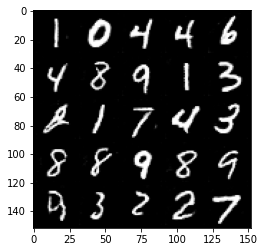

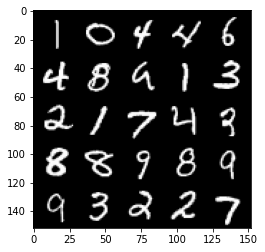

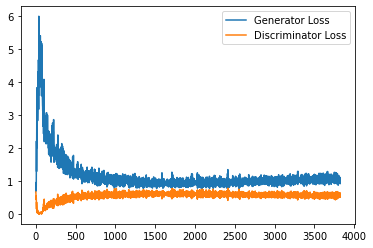

Step 77000: Generator loss: 1.0635586166381836, discriminator loss: 0.5657692805528641


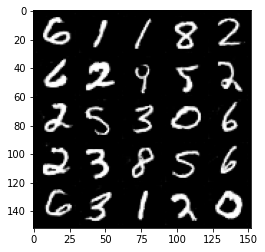

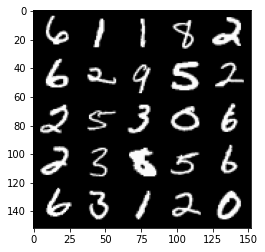

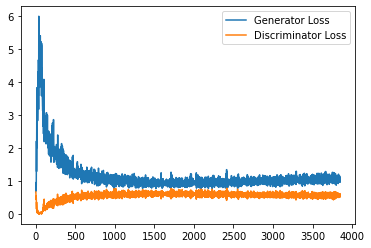

Step 77500: Generator loss: 1.070854751229286, discriminator loss: 0.5702000061869621


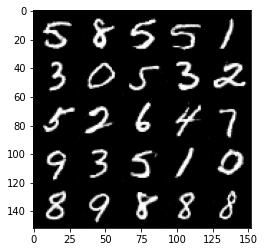

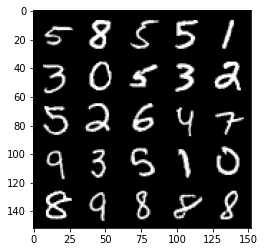

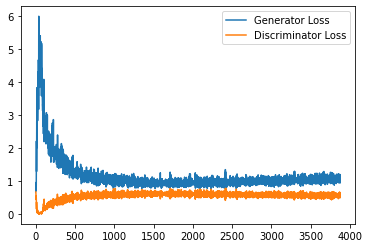

Step 78000: Generator loss: 1.0638497788906098, discriminator loss: 0.5693255326151848


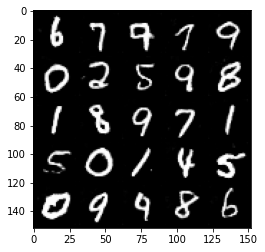

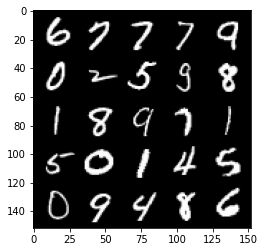

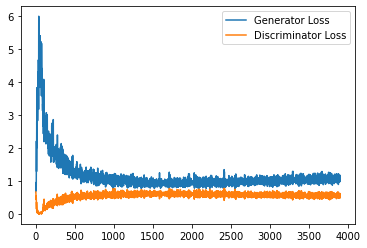

Step 78500: Generator loss: 1.065332705974579, discriminator loss: 0.5732709698081017


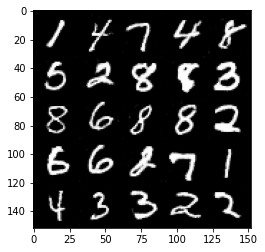

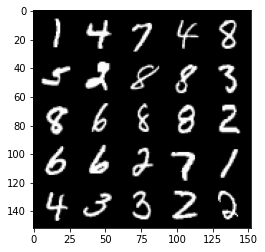

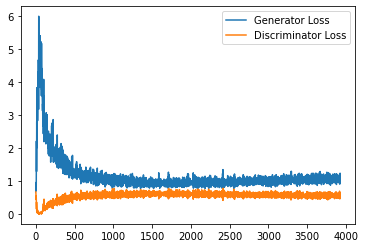

Step 79000: Generator loss: 1.0565624319314957, discriminator loss: 0.5725143223404884


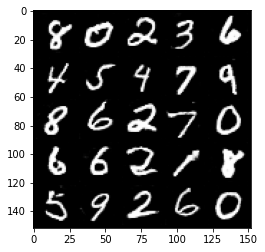

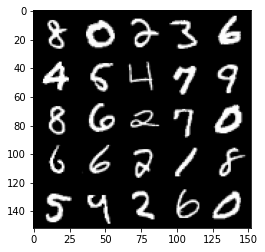

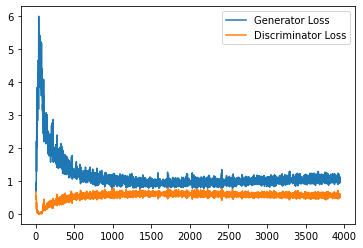

Step 79500: Generator loss: 1.073535780310631, discriminator loss: 0.5702552993893624


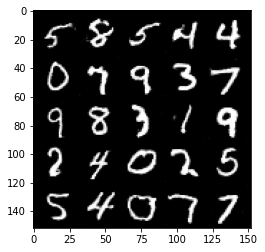

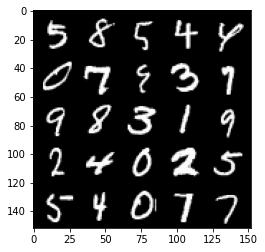

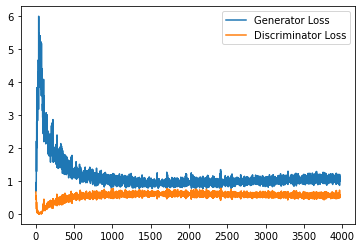

Step 80000: Generator loss: 1.0586868219375611, discriminator loss: 0.5687945395708084


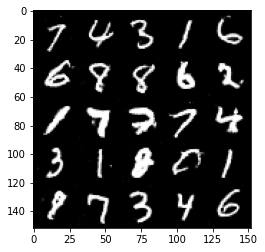

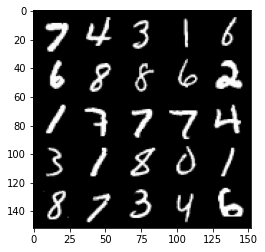

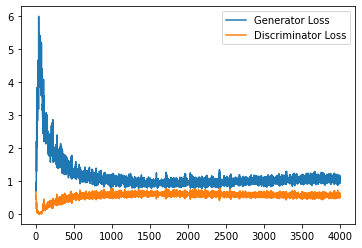

Step 80500: Generator loss: 1.0698924045562743, discriminator loss: 0.5709072061181069


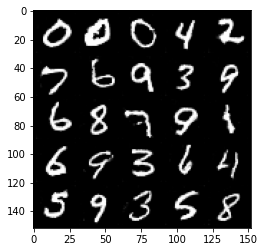

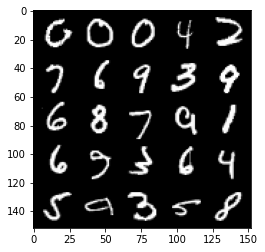

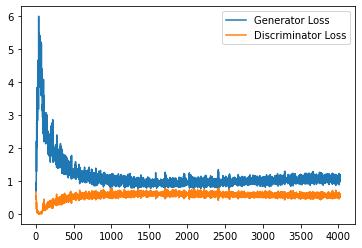

Step 81000: Generator loss: 1.0769741162061692, discriminator loss: 0.565705512881279


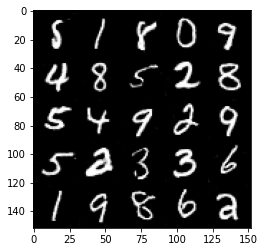

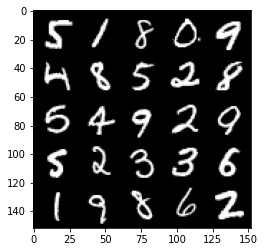

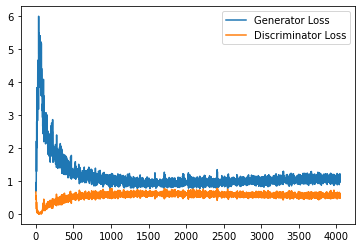

Step 81500: Generator loss: 1.0660907697677613, discriminator loss: 0.5792060925364494


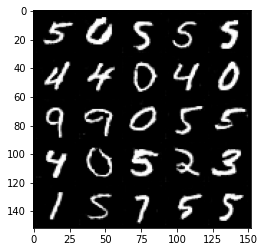

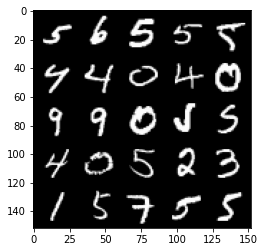

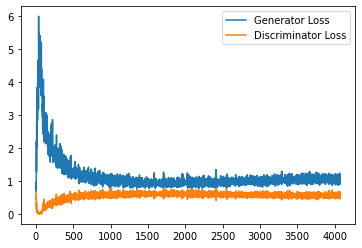

Step 82000: Generator loss: 1.062496499657631, discriminator loss: 0.572017886042595


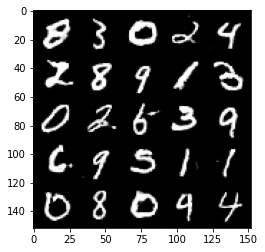

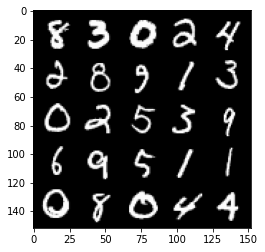

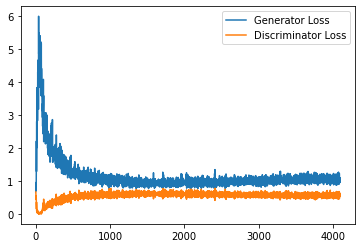

Step 82500: Generator loss: 1.070377171754837, discriminator loss: 0.5742927029132843


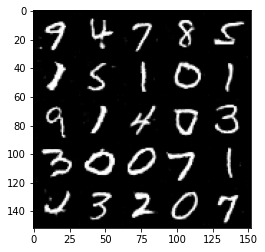

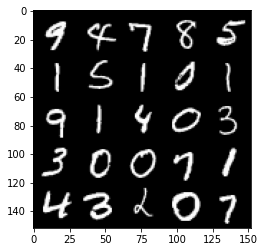

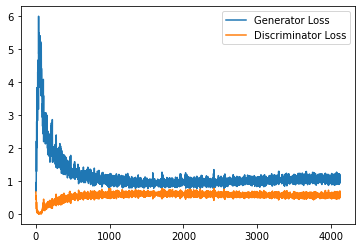

Step 83000: Generator loss: 1.0670381269454956, discriminator loss: 0.574597906768322


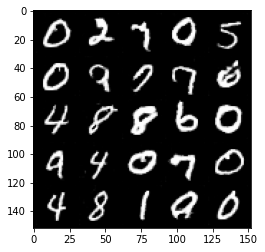

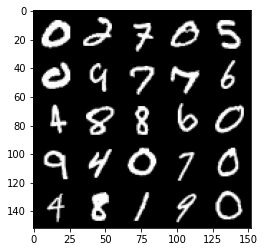

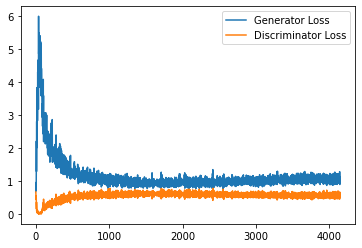

Step 83500: Generator loss: 1.0788105555772782, discriminator loss: 0.5766457241773605


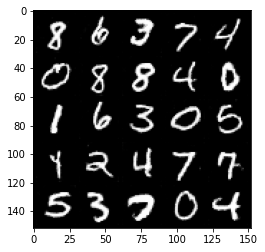

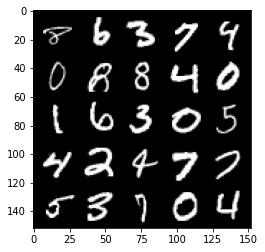

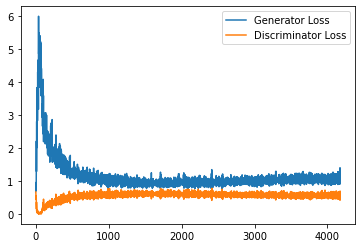

Step 84000: Generator loss: 1.0739369324445724, discriminator loss: 0.5749282967448235


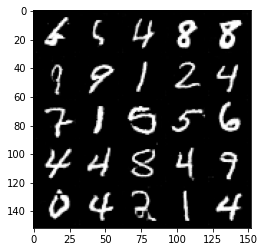

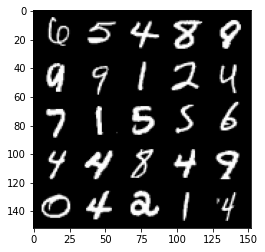

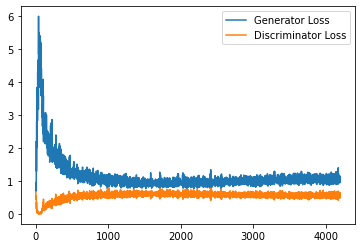

Step 84500: Generator loss: 1.07042861700058, discriminator loss: 0.5705819700956345


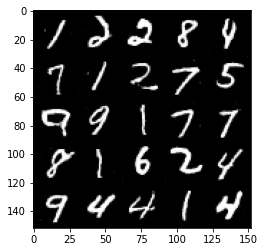

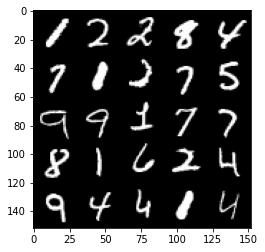

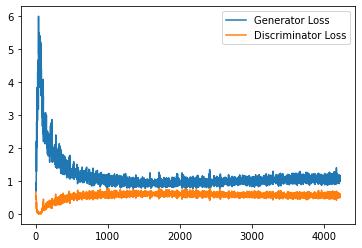

Step 85000: Generator loss: 1.0525588272809983, discriminator loss: 0.5721091130375862


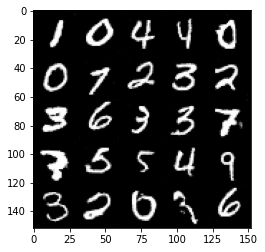

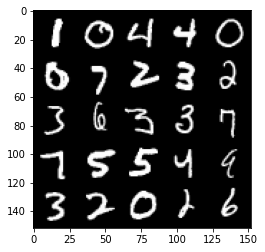

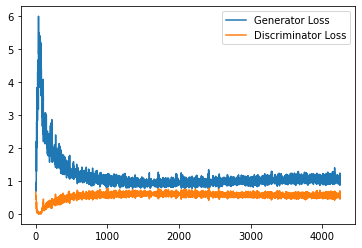

Step 85500: Generator loss: 1.0682560659646987, discriminator loss: 0.5732450503110885


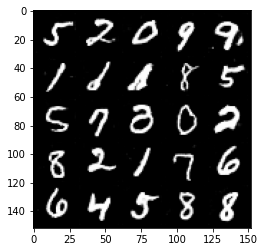

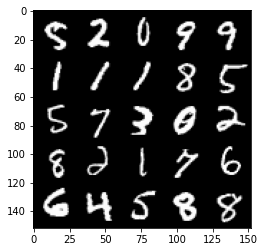

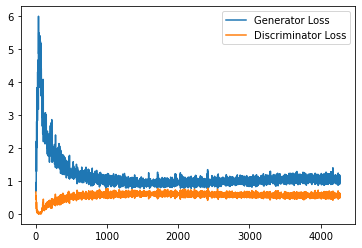

Step 86000: Generator loss: 1.0665390595197677, discriminator loss: 0.5728921582698822


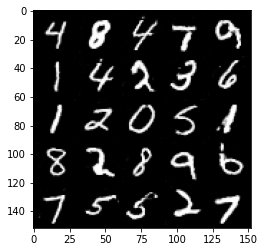

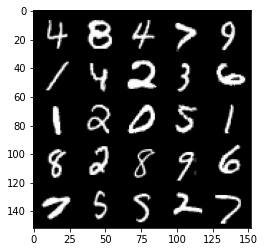

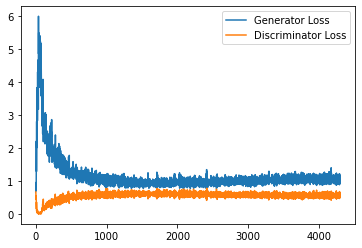

Step 86500: Generator loss: 1.060740119099617, discriminator loss: 0.5755149332880973


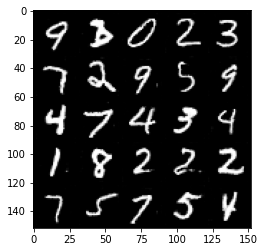

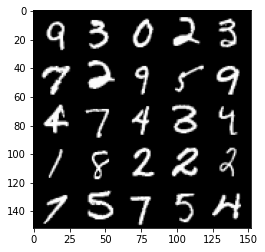

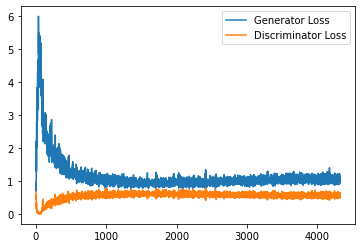

Step 87000: Generator loss: 1.0726956632137299, discriminator loss: 0.5794403869509697


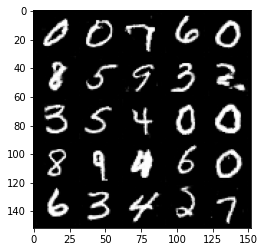

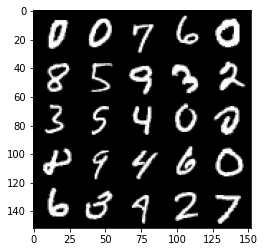

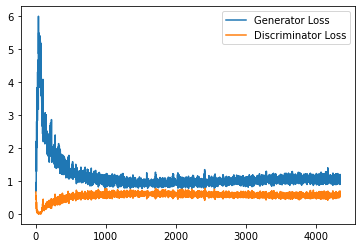

Step 87500: Generator loss: 1.0682468816041946, discriminator loss: 0.57272401958704


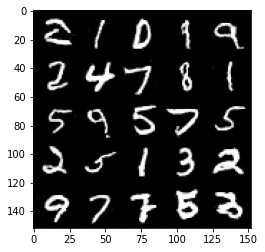

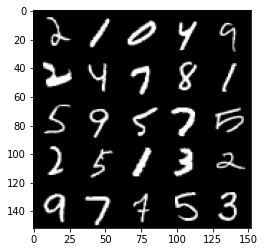

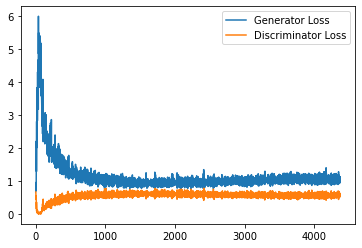

Step 88000: Generator loss: 1.0543476421833038, discriminator loss: 0.5775088554620743


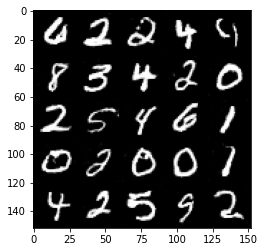

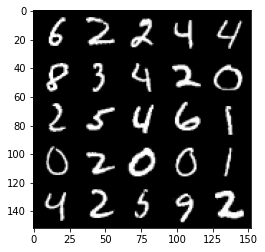

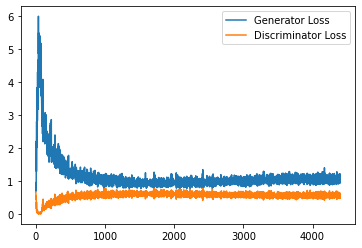

Step 88500: Generator loss: 1.062966761827469, discriminator loss: 0.5748228041529655


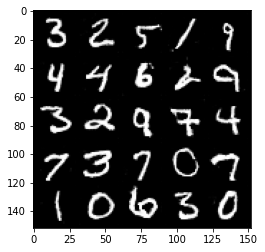

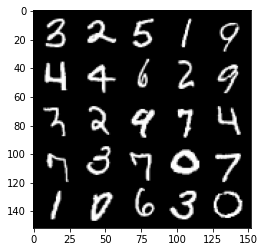

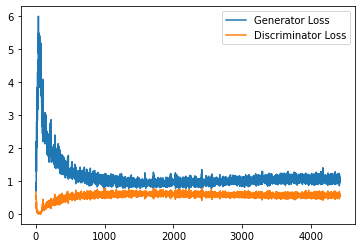

Step 89000: Generator loss: 1.0686331067085266, discriminator loss: 0.5793404964804649


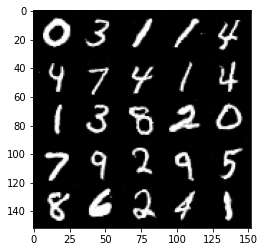

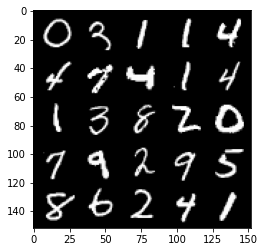

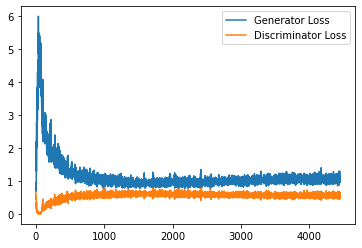

Step 89500: Generator loss: 1.0655464208126069, discriminator loss: 0.581136244893074


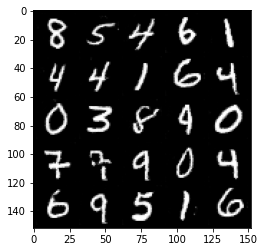

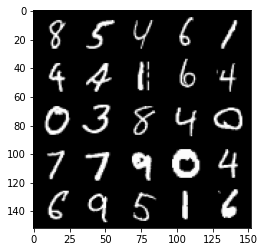

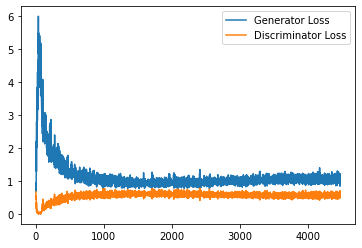

Step 90000: Generator loss: 1.072927769303322, discriminator loss: 0.5781685062646866


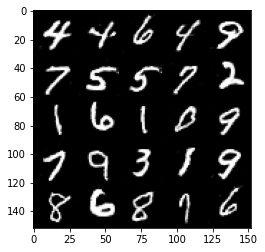

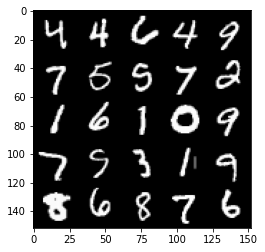

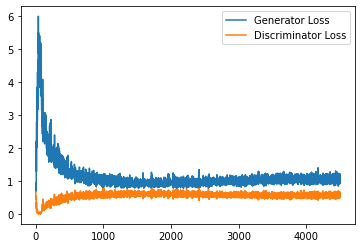

Step 90500: Generator loss: 1.052058507680893, discriminator loss: 0.5772907927036285


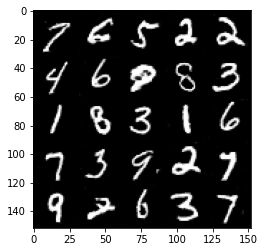

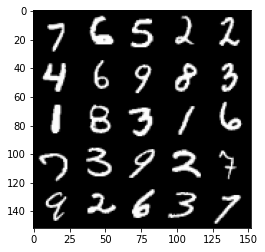

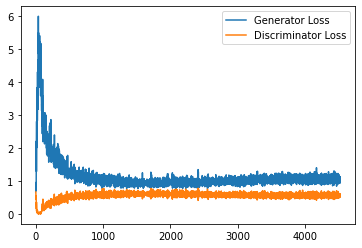

Step 91000: Generator loss: 1.0630349878668786, discriminator loss: 0.5842069796323777


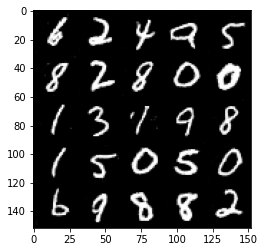

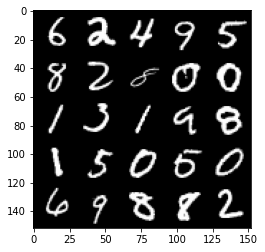

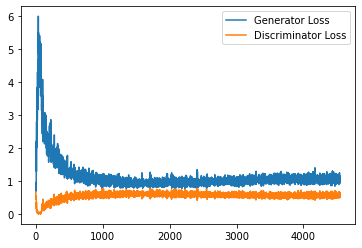

Step 91500: Generator loss: 1.0614136613607406, discriminator loss: 0.5747390452027321


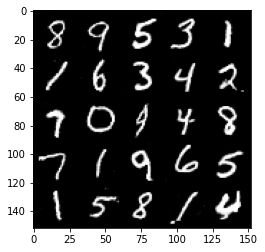

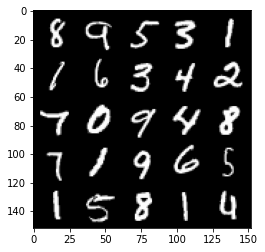

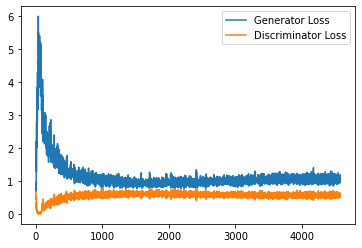

Step 92000: Generator loss: 1.0605864660739899, discriminator loss: 0.5763608952760696


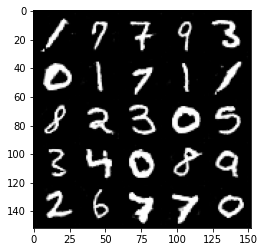

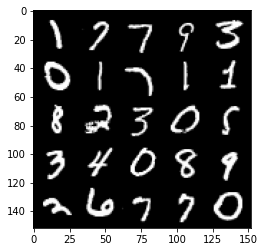

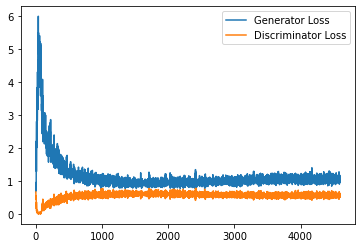

Step 92500: Generator loss: 1.0777464913129806, discriminator loss: 0.5782674618959427


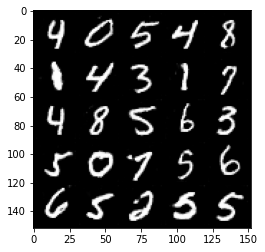

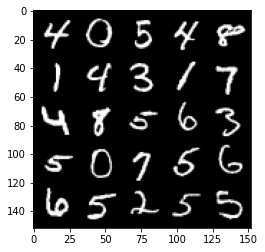

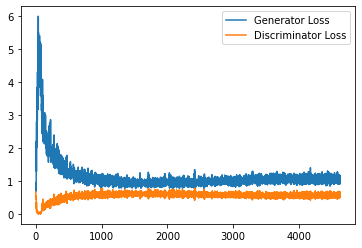

Step 93000: Generator loss: 1.0538210525512695, discriminator loss: 0.5804601606726646


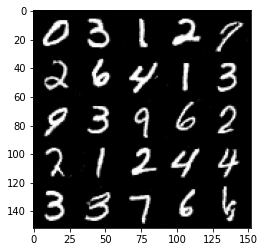

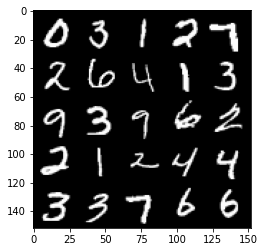

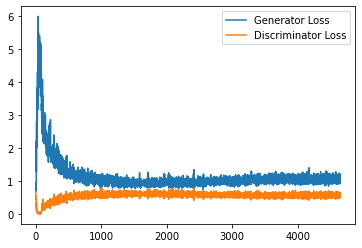

Step 93500: Generator loss: 1.0702600787878036, discriminator loss: 0.5774973570108414


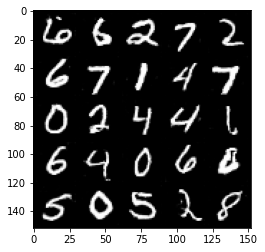

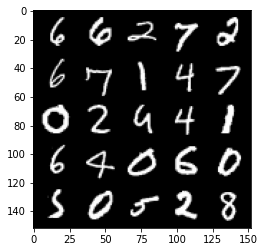

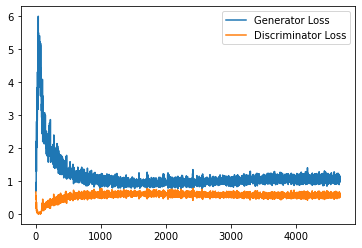

In [14]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen.forward(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc.forward(fake_image_and_labels)
        disc_real_pred = disc.forward(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [15]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

tensor([[0.0000, 1.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.8750, 0.0000, 0.0000, 0.1250, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.7500, 0.0000, 0.0000, 0.2500, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.6250, 0.0000, 0.0000, 0.3750, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.5000, 0.0000, 0.0000, 0.5000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.3750, 0.0000, 0.0000, 0.6250, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.2500, 0.0000, 0.0000, 0.7500, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.1250, 0.0000, 0.0000, 0.8750, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 1.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000]])


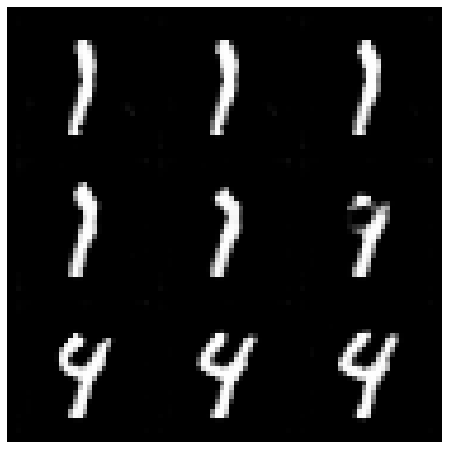

In [21]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label
    print(interpolation_labels)
    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 4 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

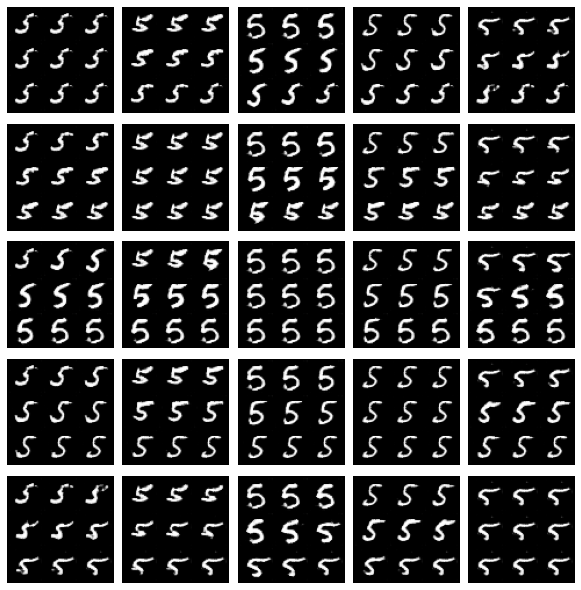

In [17]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()